In [1]:
import numpy as np
import pandas as pd
import tqdm
import re
from lightfm import LightFM

D:\anaconda3\lib\site-packages\lightfm\_lightfm_fast.py:9: UserWarning: LightFM was compiled without OpenMP support. Only a single thread will be used.
  warnings.warn('LightFM was compiled without OpenMP support. '


In [2]:
from io import BytesIO
from PIL import Image
import requests
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics.pairwise import cosine_similarity
import gensim
from scipy.sparse import coo_matrix, csr_matrix
from scipy.sparse.linalg import svds

In [3]:
Int = pd.read_csv('Interactions-3.csv')
items = pd.read_csv("items_with_text.csv")

In [4]:
Int["page_type"].value_counts()

PRODUCT     602024
CART         35396
PURCHASE      8715
Name: page_type, dtype: int64

In [5]:
Int.shape

(646135, 4)

In [6]:
items.shape

(4185, 2)

In [7]:
items.head()

,text,picture_url
0,10001833 98 monitor mr centre black oak 270 mo...,https://img.mvideo.ru/Pdb/10001833b.jpg
1,10002048 1 70997b00 300 loewe оборудование и а...,https://img.mvideo.ru/Pdb/10002048b.jpg
2,10005945 18 cybershot h300 510 sony фотоаппара...,https://img.mvideo.ru/Pdb/10005945b.jpg
3,10006755 27 ue24h4070au 360 samsung телевизор ...,https://img.mvideo.ru/Pdb/10006755b.jpg
4,10007083 53 nga5290 450 national geographic рю...,https://img.mvideo.ru/Pdb/10007083b.jpg


In [8]:
Int = Int.merge(items[["picture_url", "text"]].drop_duplicates(), on=["picture_url"])

In [118]:
Int.head()

,vid,product_id,page_type,picture_url,text
0,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
1,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
2,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
3,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
4,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...


In [9]:
def chunks(l, n):
    for i in range(0, len(l), n):
        yield l[i:i + n]

def rec_imaging(product_ids, content_dict, measure=None, top_n=5):
    picture_urls = [content_dict[i] for i in product_ids]
    cnt = 0
    for idx, chunk in enumerate(chunks(picture_urls, top_n)):
        fig = plt.figure(figsize=(20, 4))
        for n, i in enumerate(chunk):
            try:
                r = requests.get(i)
                im = Image.open(BytesIO(r.content))

            except:
                print('Something went wrong with {url}'.format(url=i))
                continue

            a = fig.add_subplot(1, top_n, n + 1)
            if measure is not None:
                a.title.set_text("measure = {}".format(np.round(measure[cnt], 4)))
                cnt += 1
            plt.imshow(im)
            plt.axis('off')
        plt.show()

# Холодный старт

# Самые популярные

In [10]:
class Top():
    def __init__(self, Int):
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def top_items(self):
        items = self.interactions[self.interactions["page_type"] == "PURCHASE"]\
                                                .groupby("product_id")["vid"].count() \
                                                .reset_index() \
                                                .sort_values("vid", ascending=False)[:30]
        
        rec_imaging(items["product_id"].values, self.product_id_to_url, items["vid"].values)

In [11]:
T = Top(Int)

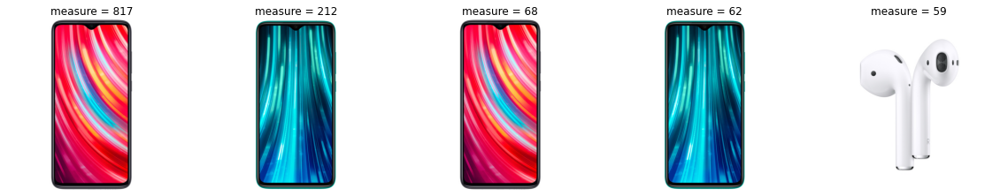

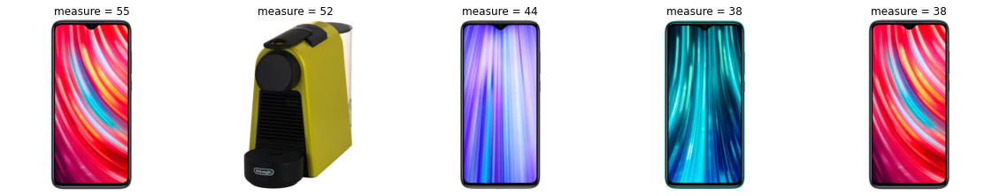

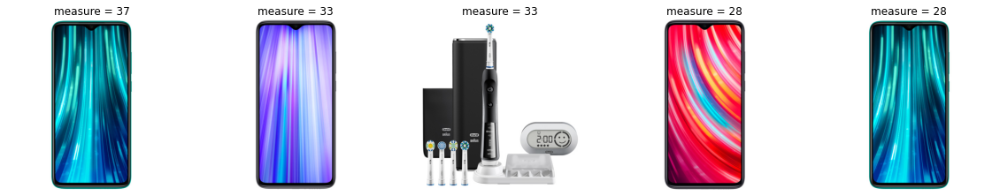

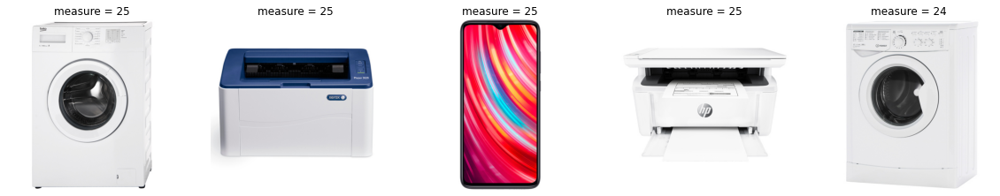

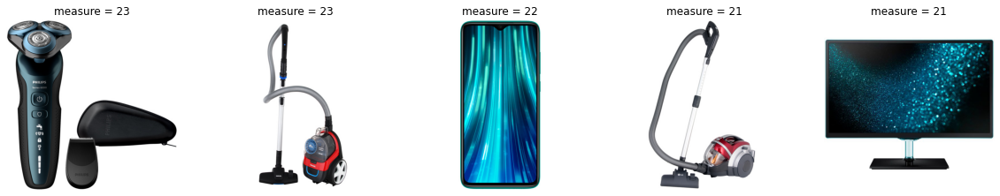

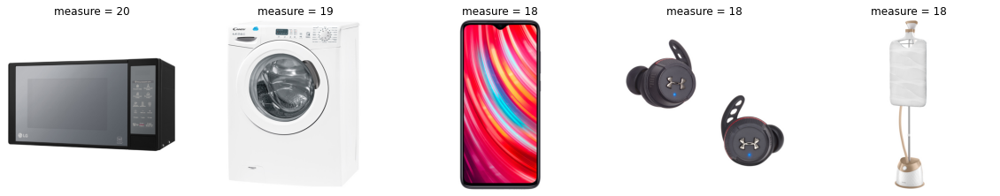

In [12]:
T.top_items()

# Cовстречаемость

In [13]:
class Recomendations():
    def __init__(self, Int):
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def coocurrency_count(self):
        Int = self.interactions[["vid", "product_id"]].drop_duplicates()
        user_products = Int.groupby(["vid"])["product_id"].apply(list).reset_index()
        product_num = [len(i) for i in user_products["product_id"]]
        user_products["prod_num"] = product_num
        user_products = user_products[user_products["prod_num"] > 1]
        
        cooc = {}
        for i in tqdm.tqdm_notebook(user_products.values):
            for j in range(len(i[1])):
                for k in range(len(i[1])):
                    if j != k:
                        try:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] += 1
                        except:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] = 1
        cooc_list = []
        for i, j in cooc.items():
            if j != 1:
                cooc_list.append(i.split("_") + [j])
        self.cooc_rec = pd.DataFrame(cooc_list, columns=["item1", "item2", "measure"])
    
    def get_rec(self, i, show=False):
        recs = self.cooc_rec[self.cooc_rec["item1"] == str(i)]\
                            .sort_values("measure", ascending=False)\
                            .head(10)
        print(u"Для товара")
        rec_imaging([i], self.product_id_to_url)
        print(u"Такие рекомендации")
        rec_imaging(recs["item2"].values.astype(int), self.product_id_to_url, 
                         recs["measure"].values.astype(int))

In [14]:
cooc_rec = Recomendations(Int)
cooc_rec.coocurrency_count()

<ipython-input-13-5d97cf776d3a>:16: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i in tqdm.tqdm_notebook(user_products.values):


Для товара


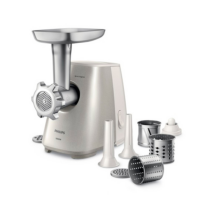

Такие рекомендации


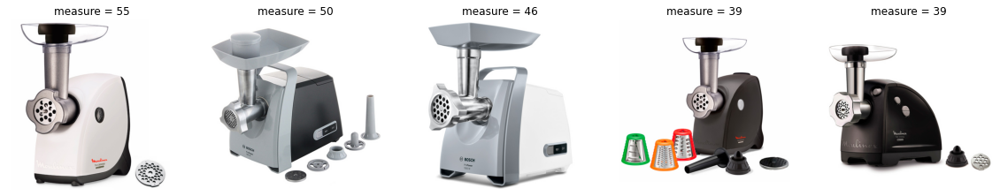

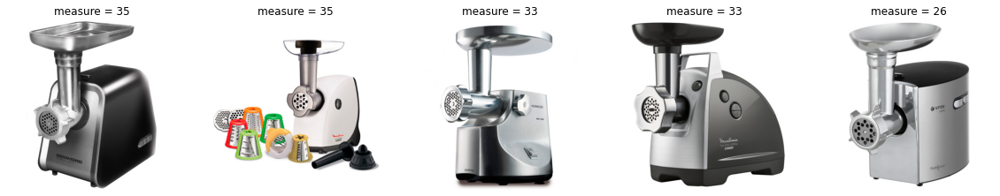

In [15]:
cooc_rec.get_rec(10)

Для товара


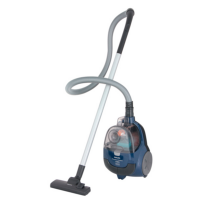

Такие рекомендации


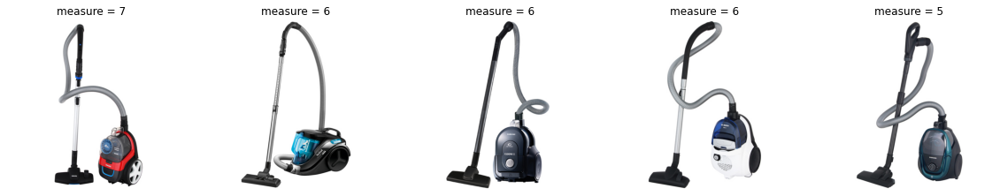

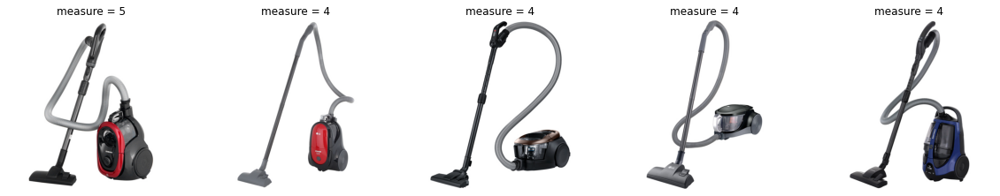

In [16]:
cooc_rec.get_rec(121)

Для товара


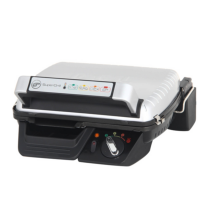

Такие рекомендации


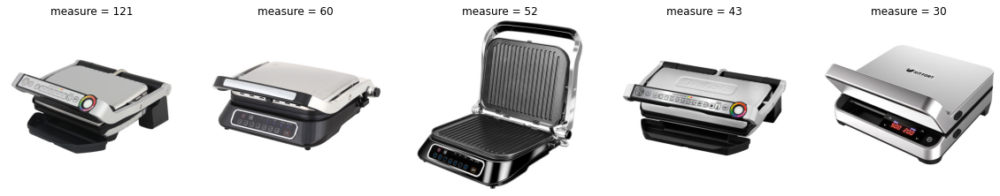

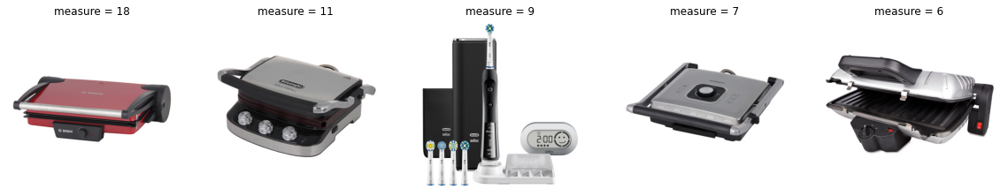

In [17]:
cooc_rec.get_rec(42)

Для товара


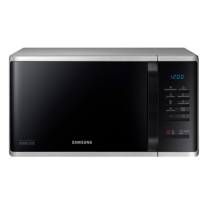

Такие рекомендации


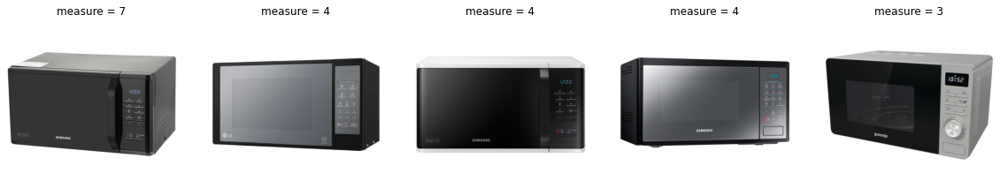

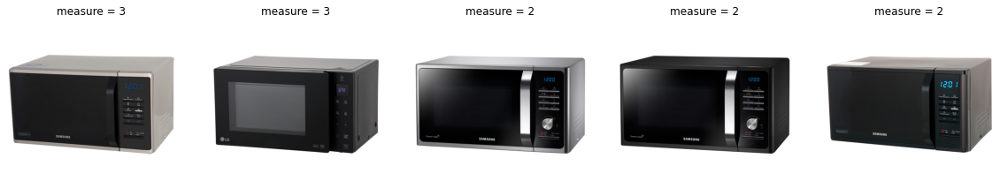

In [18]:
cooc_rec.get_rec(1111)

Для товара


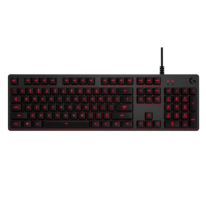

Такие рекомендации


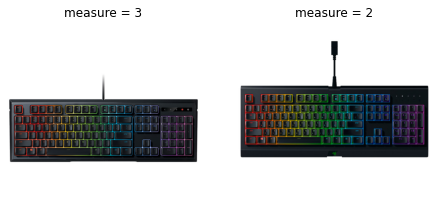

In [19]:
cooc_rec.get_rec(1236)

Для товара


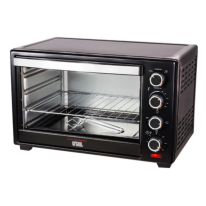

Такие рекомендации


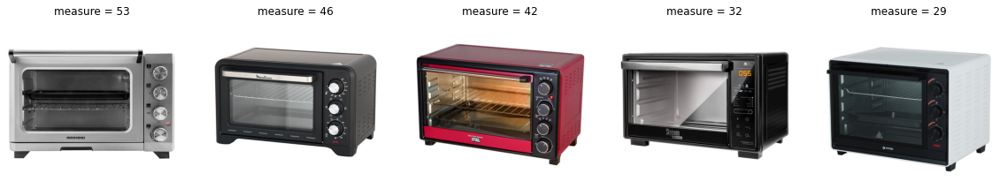

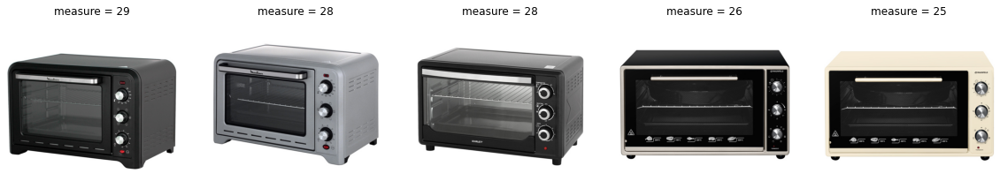

In [20]:
cooc_rec.get_rec(1362)

Для товара


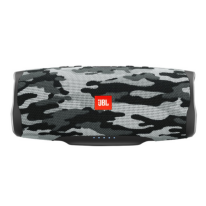

Такие рекомендации


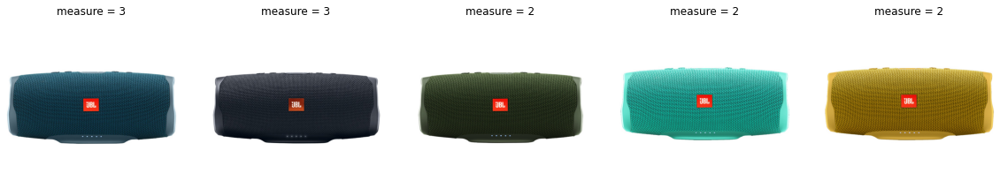

In [20]:
cooc_rec.get_rec(1002)

Для товара


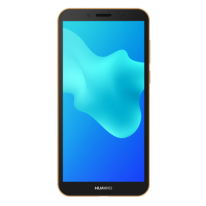

Такие рекомендации


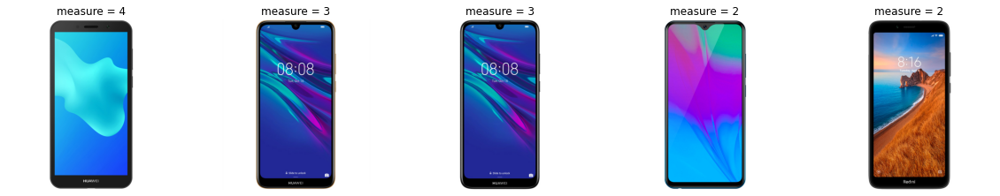

In [21]:
cooc_rec.get_rec(1245)

Для товара


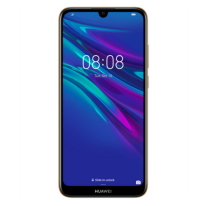

Такие рекомендации


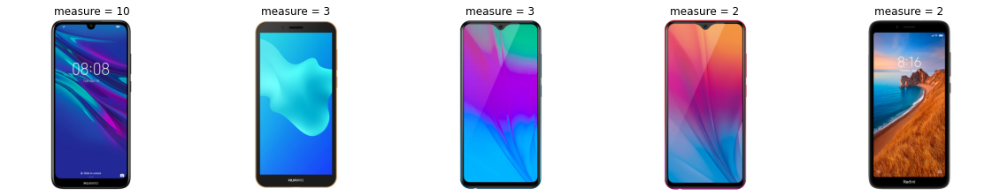

In [22]:
cooc_rec.get_rec(1247)

Для товара


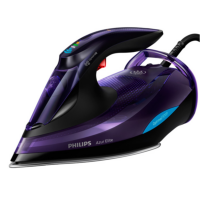

Такие рекомендации


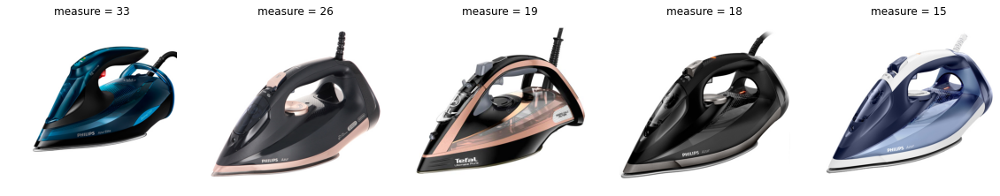

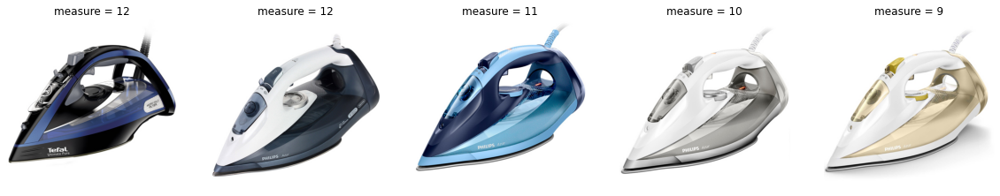

In [23]:
cooc_rec.get_rec(3453)

Для товара


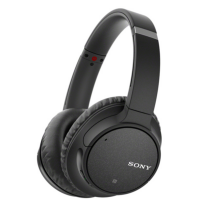

Такие рекомендации


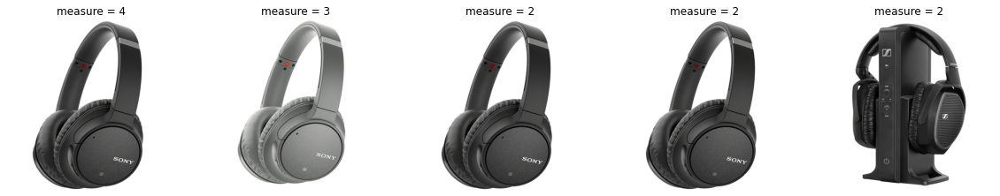

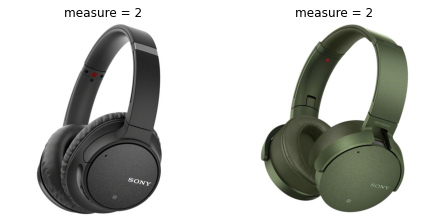

In [24]:
cooc_rec.get_rec(3445)

Для товара


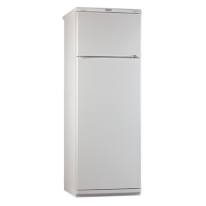

Такие рекомендации


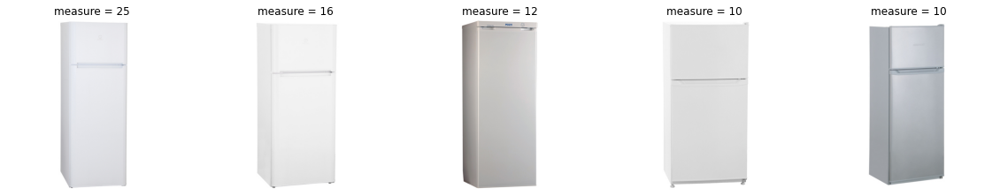

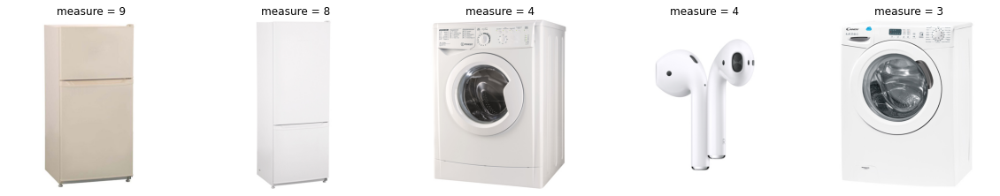

In [25]:
cooc_rec.get_rec(667)

Для товара


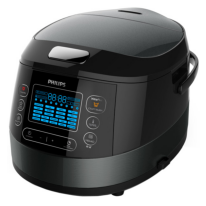

Такие рекомендации


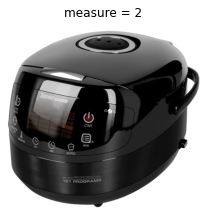

In [26]:
cooc_rec.get_rec(1231)

Для товара


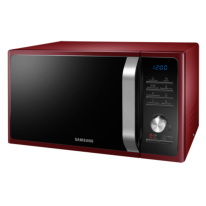

Такие рекомендации


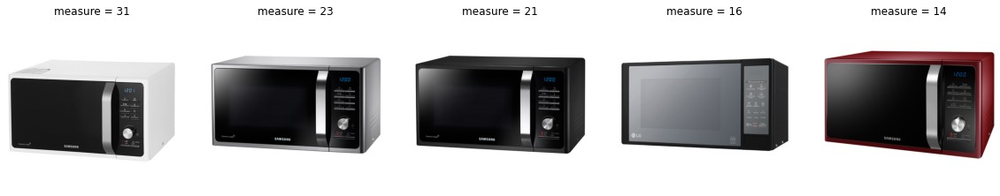

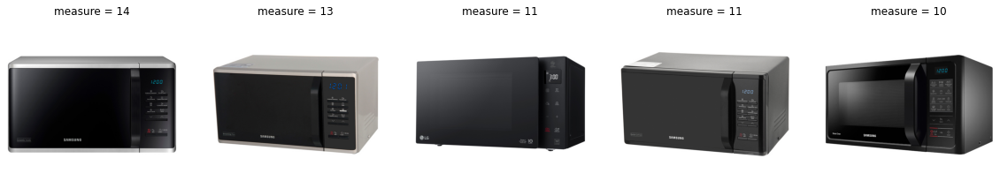

In [27]:
cooc_rec.get_rec(1226)

Для товара


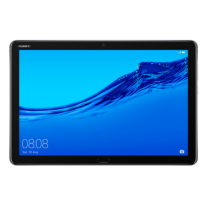

Такие рекомендации


In [28]:
cooc_rec.get_rec(1212)

Для товара


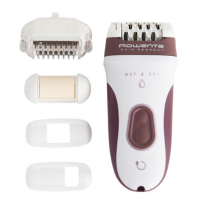

Такие рекомендации


In [29]:
cooc_rec.get_rec(631)

# Content-based

In [21]:
class Content_Based():
    def __init__(self, items, interactions):
        self.items = items
        self.interactions = interactions
        self.content_dict = {}
        for i, j in enumerate(items["picture_url"]):
            self.content_dict[i] = j
        self.inversed_dict = {v: k for k, v in self.content_dict.items()}
        
    def avg_feature_vector(self, words, model, num_features, index2word_set):
        feature_vec = np.zeros((num_features, ), dtype='float32')
        n_words = 0
        for word in words:
            if word in index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec

    def get_items_representation(self):
        
        item_description = [gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", i.lower())) 
                            for i in self.items['text']]
        #build vocabulary and train model
        self.model = gensim.models.Word2Vec(
                item_description,
                size=200,
                window=10,
                min_count=1,
                workers=10,
                iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        self.items_embs = np.zeros((len(item_description), 200))
        for i in range(self.items_embs.shape[0]):
            self.items_embs[i] = self.avg_feature_vector(item_description[i], self.model, 200, self.index2word_set)
        
        
    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])


    def get_rec_U2I(self, i):
        ui = self.interactions[self.interactions["vid"] == i]
        user_vector = " ".join(ui["text"])
        user_processed = gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", user_vector.lower()))
        user_emb = self.avg_feature_vector(user_processed, self.model, 200, self.index2word_set)
        metrics = cosine_similarity([user_emb], self.items_embs)
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(np.unique([self.inversed_dict[i] for i in ui["picture_url"]]), self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])

In [22]:
CB = Content_Based(items, Int)

In [23]:
CB.get_items_representation()

Для товара


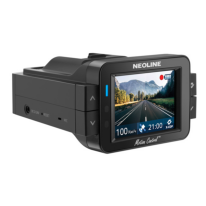

Такие рекомендации


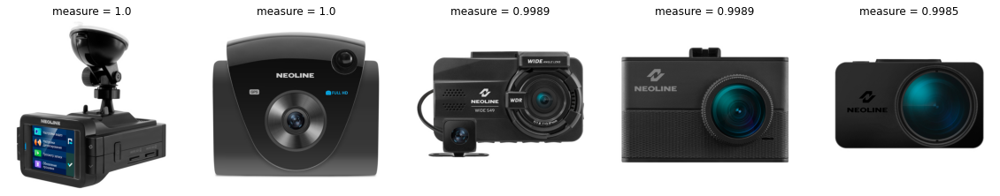

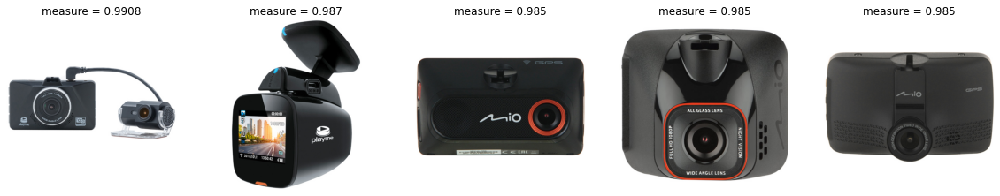

In [24]:
CB.get_rec_I2I(13)

Для товара


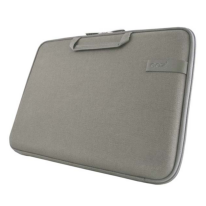

Такие рекомендации


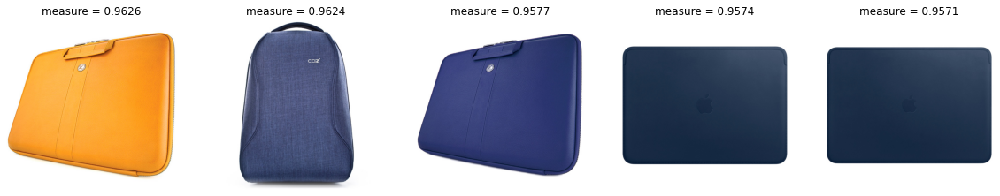

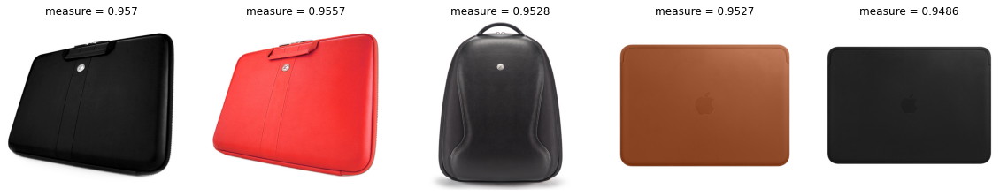

In [25]:
CB.get_rec_I2I(1234)

Для пользователя, который взаимодействовал с товарами


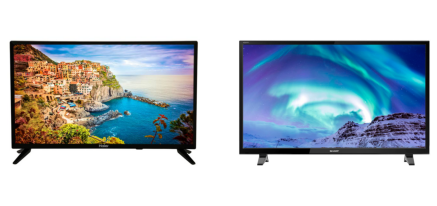

Такие рекомендации


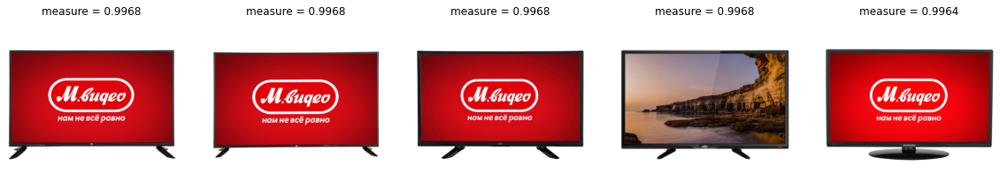

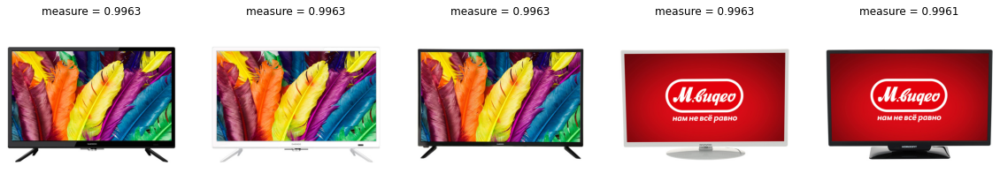

In [35]:
CB.get_rec_U2I(3212)

Для пользователя, который взаимодействовал с товарами


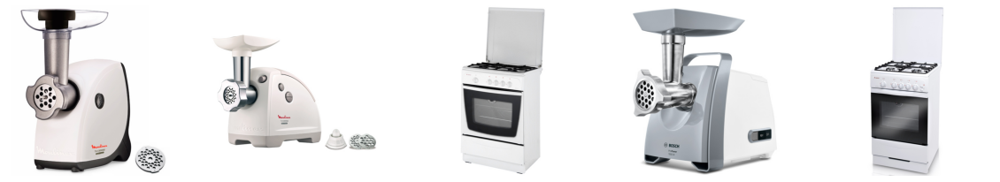

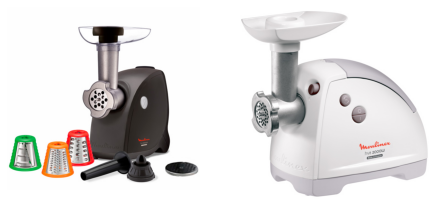

Такие рекомендации


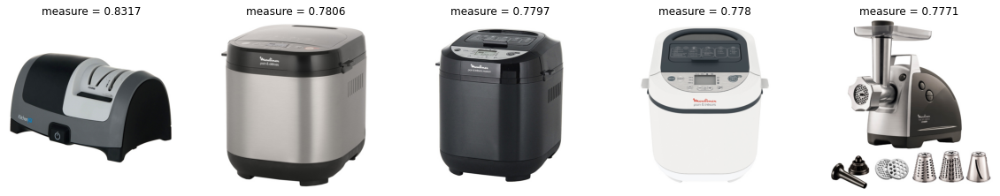

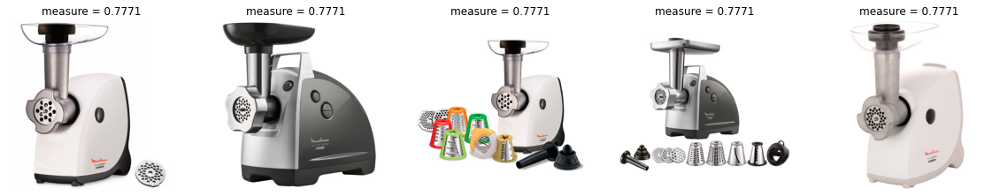

In [36]:
CB.get_rec_U2I(333)

Для пользователя, который взаимодействовал с товарами


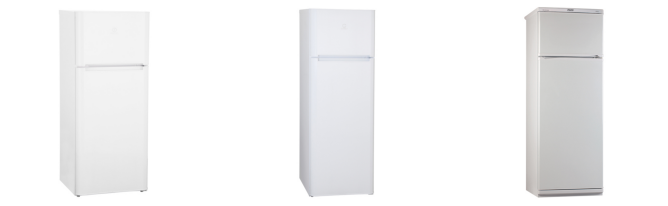

Такие рекомендации


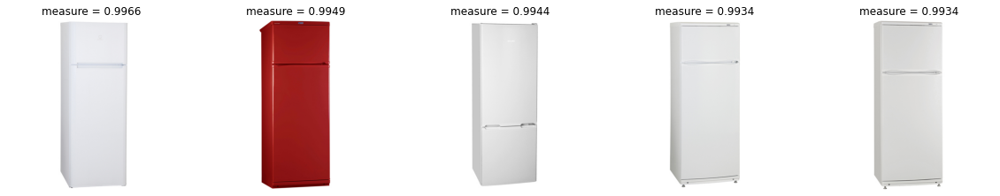

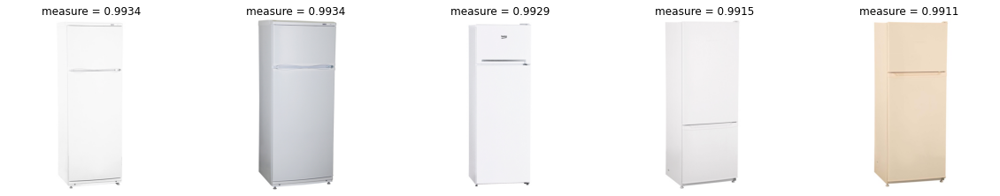

In [37]:
CB.get_rec_U2I(112)

Для пользователя, который взаимодействовал с товарами


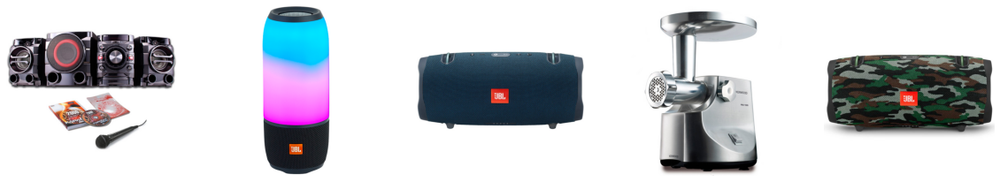

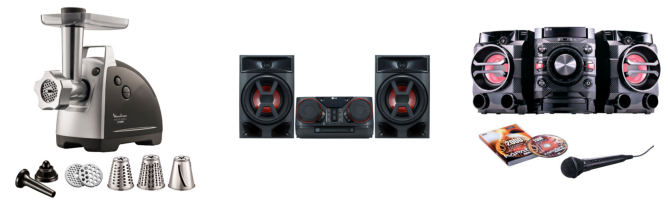

Такие рекомендации


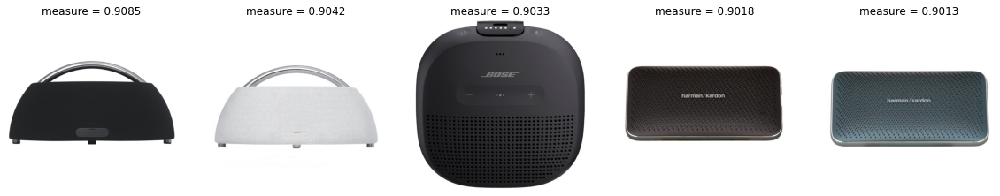

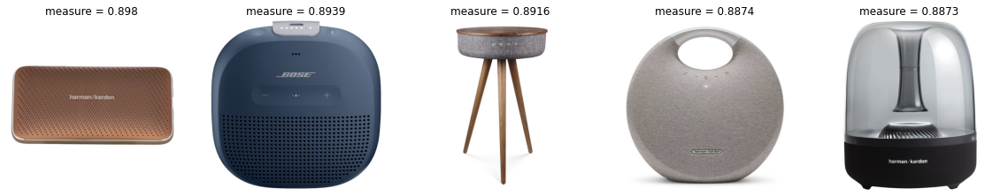

In [38]:
CB.get_rec_U2I(777)

# W2V recommendations

In [26]:
class W2V_REC():
    def __init__(self, interactions):
        self.interactions = interactions
        self.interactions["product_id"] = self.interactions["product_id"].astype(str)
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j

    def get_w2v(self):
        interactions_sentences = self.interactions.groupby(["vid"])["product_id"].apply(list).reset_index()
        self.model = gensim.models.Word2Vec(
                                        interactions_sentences["product_id"].apply(list).values,
                                        size=200,
                                        window=10,
                                        min_count=1,
                                        workers=10,
                                        iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        
    def avg_feature_vector(self, words):
        feature_vec = np.zeros(200, dtype='float32')
        n_words = 0
        for word in words:
            if word in self.index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, self.model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec
    
    def get_rec_I2I(self, i):
        metrics = [j[1] for j in self.model.wv.similar_by_word(i)]
        items = [j[0] for j in self.model.wv.similar_by_word(i)]
        print(u"Для товара")
        r = requests.get(self.content_dict[i])
        im = Image.open(BytesIO(r.content))
        plt.imshow(im)
        plt.axis('off')
        plt.show()
        print(u"Такие рекомендации")
        rec_imaging(items, self.content_dict, metrics)

    def get_rec_U2I(self, i):
        user_items = list(self.interactions[self.interactions["vid"] == i]["product_id"].drop_duplicates())
        user_emb = self.avg_feature_vector(user_items)
        recs = self.model.wv.most_similar(positive=[user_emb], topn=10)
        metrics = [j[1] for j in recs]
        items = [j[0] for j in recs]
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(user_items, self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(items, self.content_dict, metrics)

In [27]:
w = W2V_REC(Int)
w.get_w2v()

Для товара


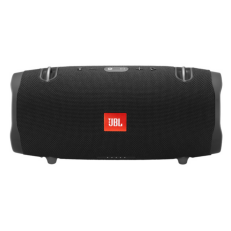

Такие рекомендации


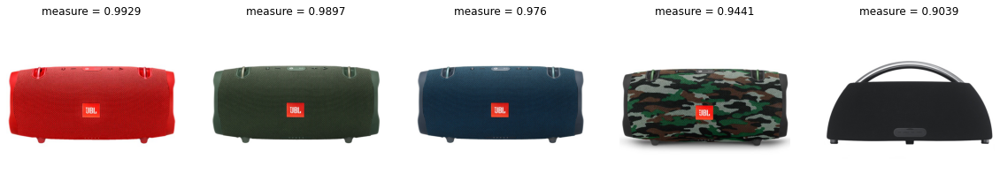

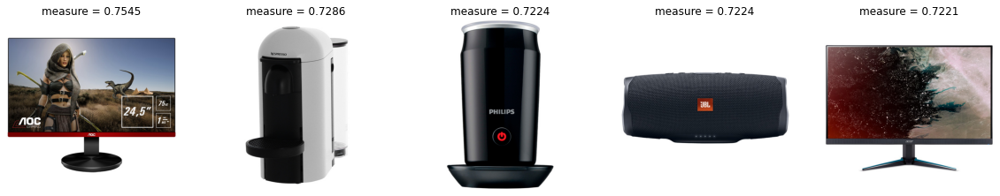

In [28]:
w.get_rec_I2I("0")

Для товара


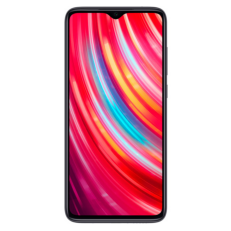

Такие рекомендации


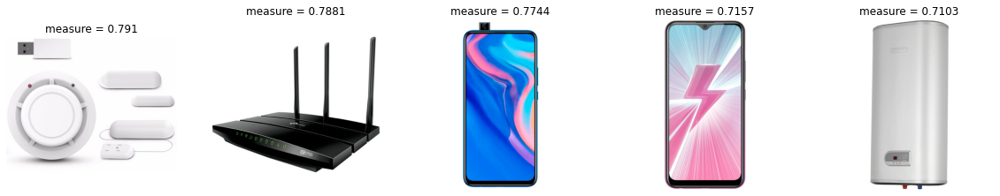

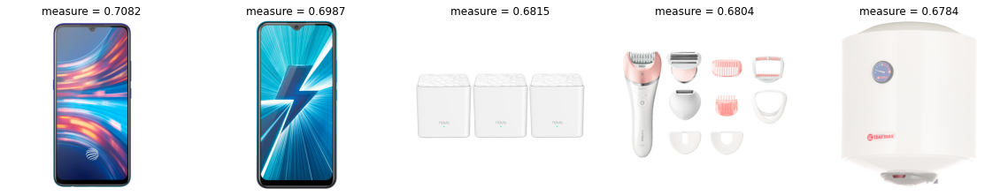

In [29]:
w.get_rec_I2I("1")

Для пользователя, который взаимодействовал с товарами


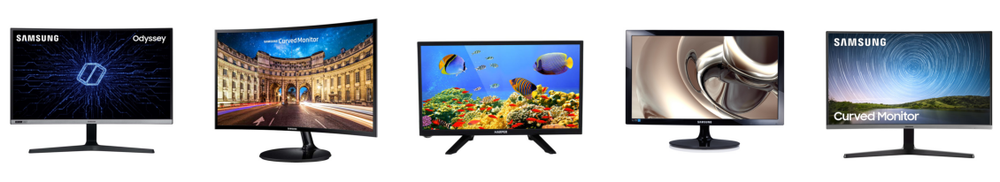

Такие рекомендации


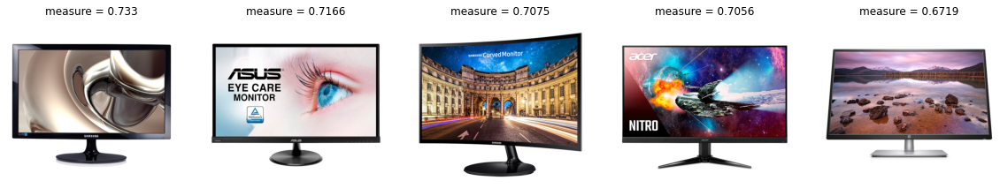

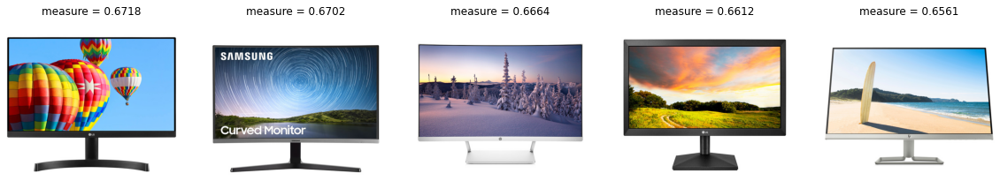

In [30]:
w.get_rec_U2I(2122)

Для пользователя, который взаимодействовал с товарами


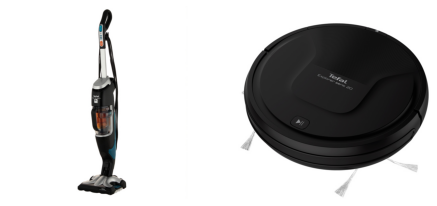

Такие рекомендации


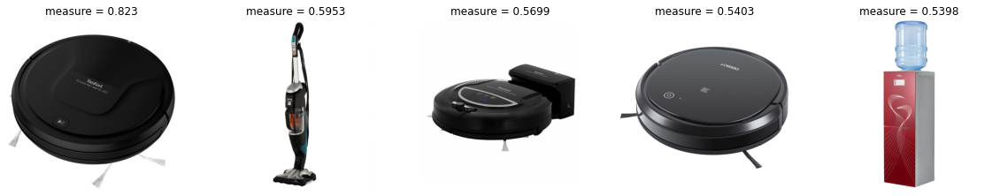

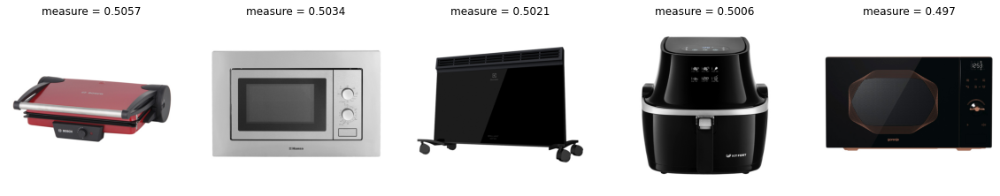

In [31]:
w.get_rec_U2I(4322)

Для пользователя, который взаимодействовал с товарами


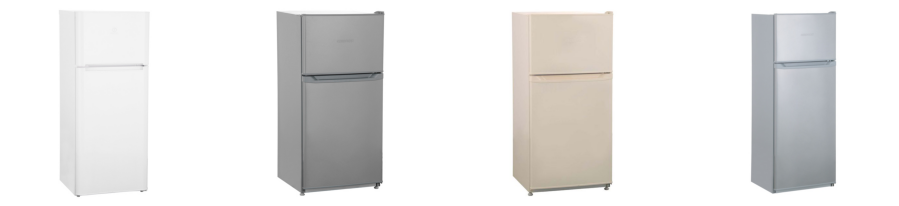

Такие рекомендации


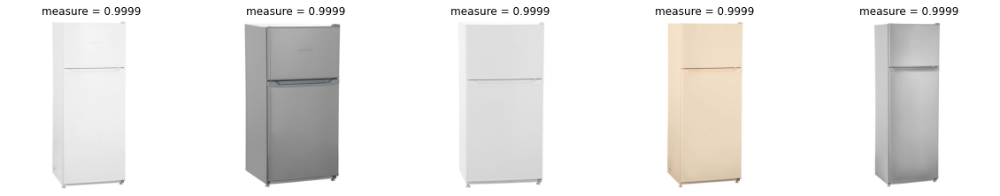

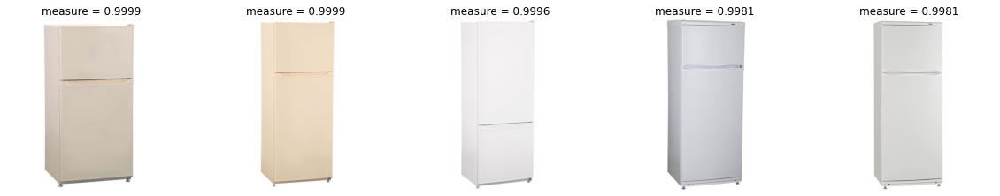

Для пользователя, который взаимодействовал с товарами


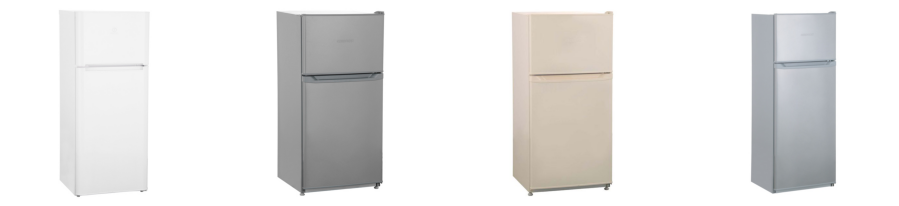

Такие рекомендации


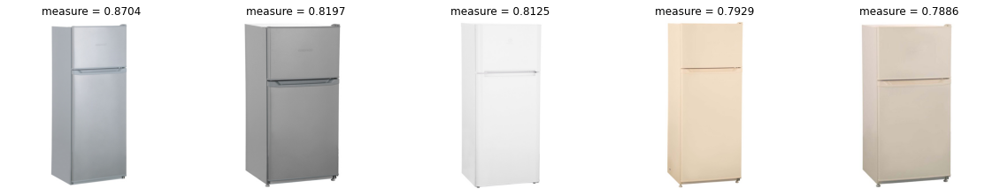

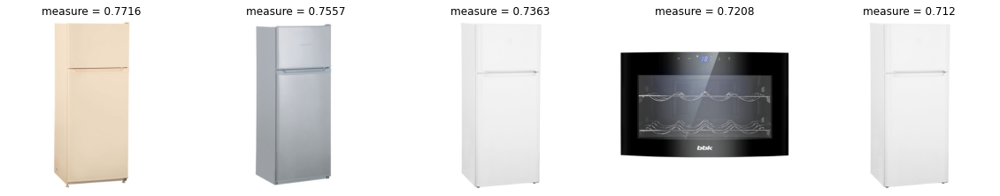

In [45]:
user = 121
CB.get_rec_U2I(user)
w.get_rec_U2I(user)

# Colloborative filtering

In [32]:
df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                           'weight': [1, 1, 1]})
weighted = Int.merge(df_weights, on="page_type")\
                  .groupby(["vid", "product_id", "picture_url"])["weight"]\
                  .sum()\
                  .reset_index()

In [33]:
weighted["weight"] = (weighted["weight"] > 0).astype(int)

In [34]:
csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                    shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))

In [35]:
csr_rates

<129920x60080 sparse matrix of type '<class 'numpy.int32'>'
	with 359731 stored elements in COOrdinate format>

In [36]:
user_rates = csr_rates.getrow(12).toarray()[0]

In [37]:
cosine_similarity([user_rates], csr_rates).reshape(-1, 1).shape

(129920, 1)

In [38]:
idx = 0

In [39]:
user_rates = csr_rates.getrow(idx).toarray()[0]
watched_items = np.where(user_rates != 0)[0]
metrics = cosine_similarity([user_rates], csr_rates).reshape(-1, 1)
# домножаем оценки пользователя на коэффициент похожести
rates = csr_matrix.multiply(csr_rates.copy(), metrics)

In [40]:
user_rates

array([1, 0, 0, ..., 0, 0, 0], dtype=int32)

In [41]:
metrics

array([[1.        ],
       [0.70710678],
       [0.40824829],
       ...,
       [0.        ],
       [0.        ],
       [0.        ]])

In [56]:
csr_rates.toarray()

MemoryError: Unable to allocate 29.1 GiB for an array with shape (129920, 60080) and data type int32

In [42]:
rates.shape

(129920, 60080)

In [43]:
class Colloborative():
    def __init__(self, interactions):
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[int(i)] = j
        df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                                   'weight': [1, 1, 1]})
        weighted = interactions.merge(df_weights, on="page_type")\
                          .groupby(["vid", "product_id", "picture_url"])["weight"]\
                          .sum()\
                          .reset_index()
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        self.csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        

    def user_based(self, idx):
        # считаем косинус между пользователем idx и всеми пользователями
        user_rates = self.csr_rates.getrow(idx).toarray()[0]
        watched_items = np.where(user_rates != 0)[0]
        metrics = cosine_similarity([user_rates], self.csr_rates).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.copy(), metrics)
        # чтобы не рекомендовать уже просмотренные - зануляем веса просмотренных
        total_rate = (1 - user_rates.astype(bool)) * np.array(np.sum(rates, axis=0))[0]
        # печатаем рекомендации
        self.get_rec(watched_items, np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])
        
    def item_based(self, idx):
        # считаем косинус между пользователем idx и всеми пользователями
        item_rates = self.csr_rates.getcol(idx).toarray().reshape(1, -1)
        metrics = cosine_similarity(item_rates, self.csr_rates.T).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.T.copy(), metrics)
        total_rate = np.array(np.sum(rates, axis=1)).ravel()
        # печатаем рекомендации
        self.get_rec([idx], np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])

    def get_rec(self, watched, recs, measure):
        print(u"Для таких товаров")
        rec_imaging([i for i in watched], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging([i for i in recs], self.content_dict, measure)

In [44]:
clb = Colloborative(Int)

Для таких товаров


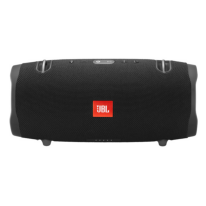

Такие рекомендации


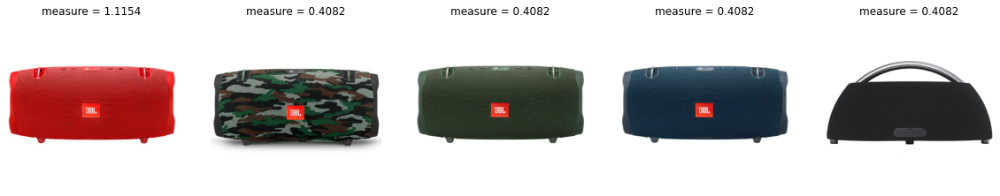

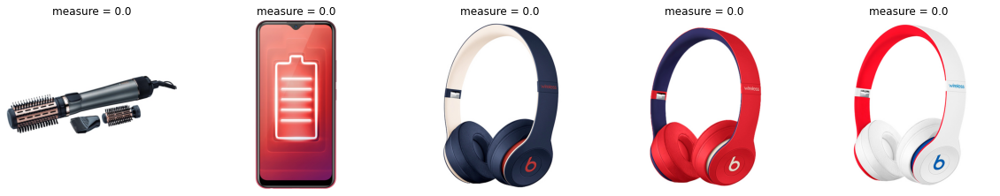

In [45]:
clb.user_based(0)

Для таких товаров


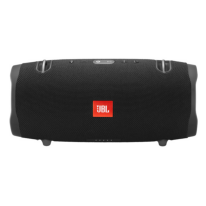

Такие рекомендации


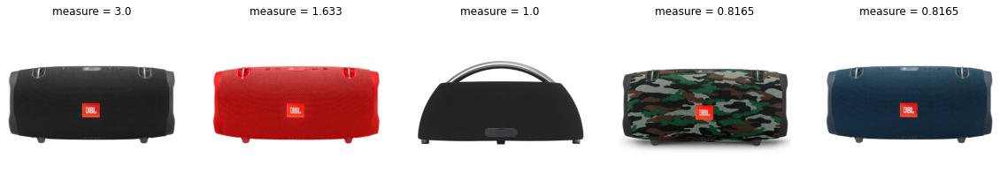

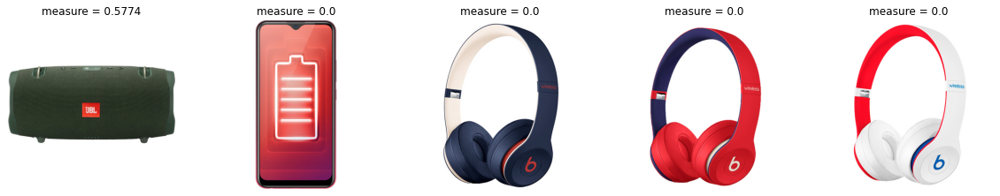

In [46]:
clb.item_based(0)

Для таких товаров


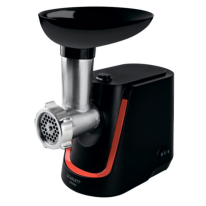

Такие рекомендации


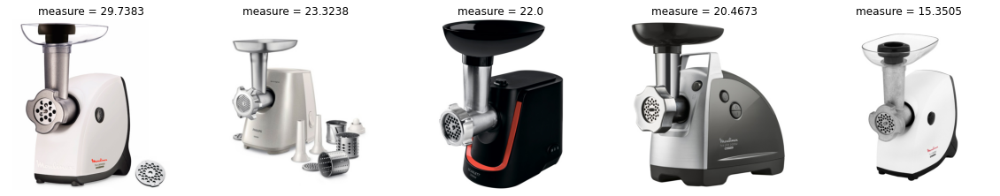

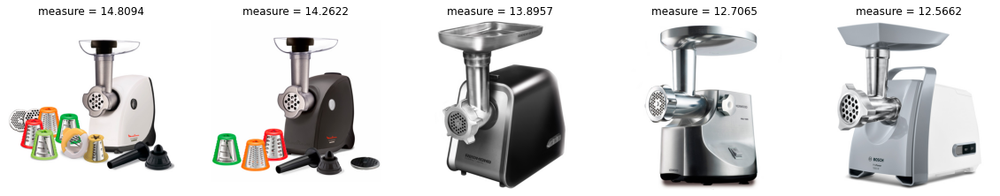

In [62]:
clb.item_based(12)

Для таких товаров


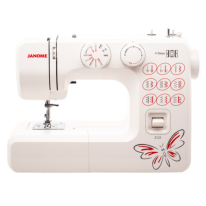

Такие рекомендации


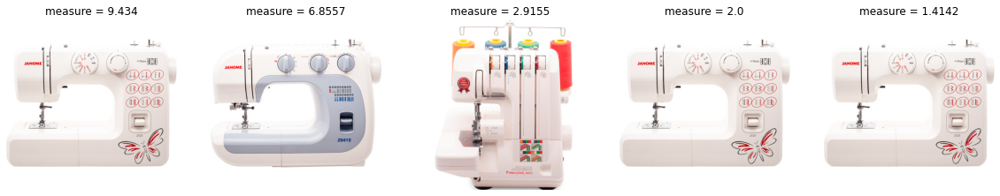

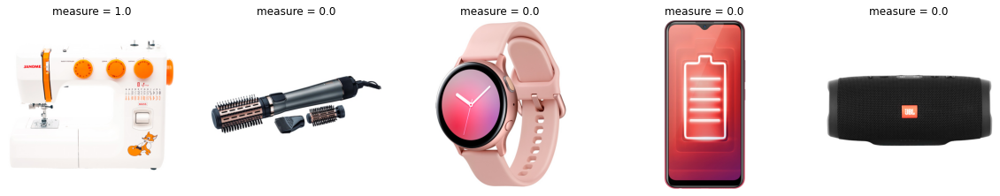

In [63]:
clb.item_based(31211)

Для таких товаров


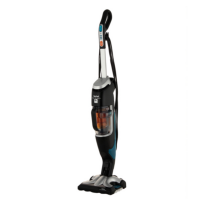

Такие рекомендации


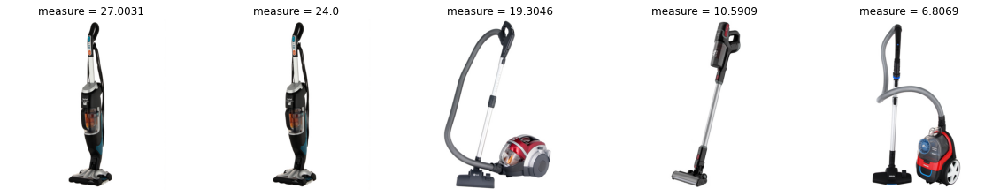

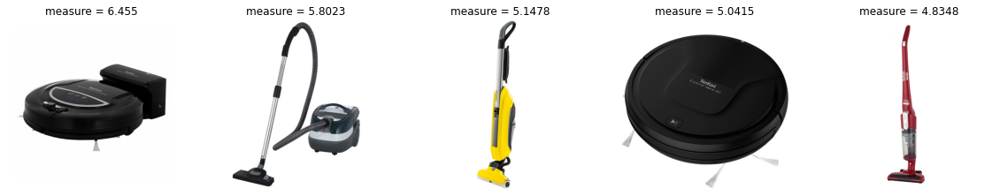

In [64]:
clb.item_based(2556)

Для таких товаров


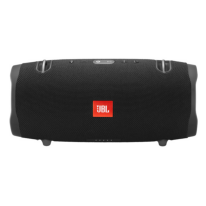

Такие рекомендации


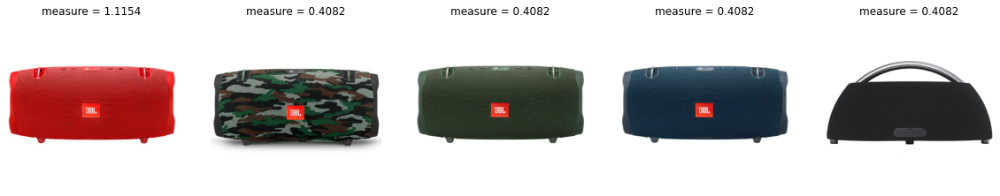

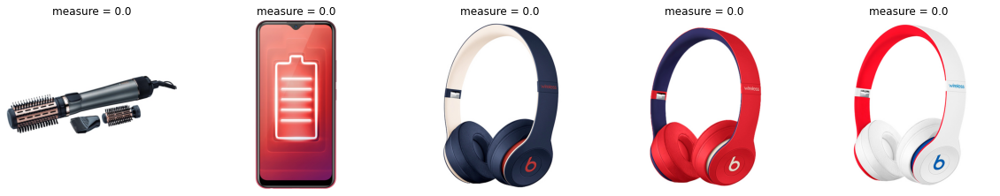

In [65]:
clb.user_based(0)

Для таких товаров


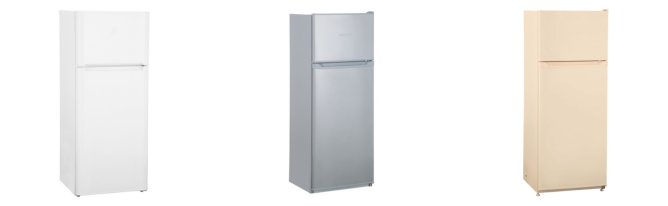

Такие рекомендации


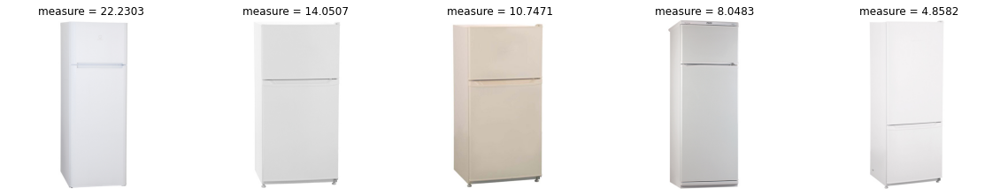

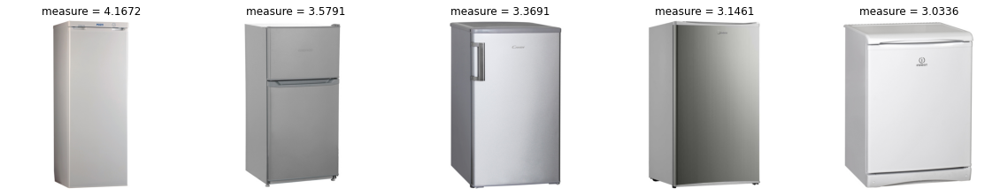

In [66]:
clb.user_based(123)

Для таких товаров


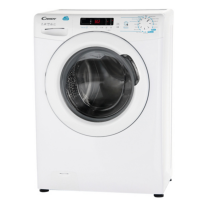

Такие рекомендации


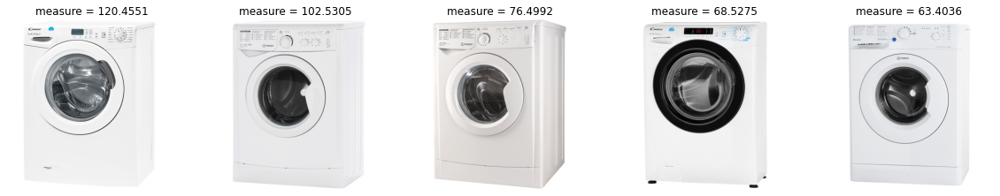

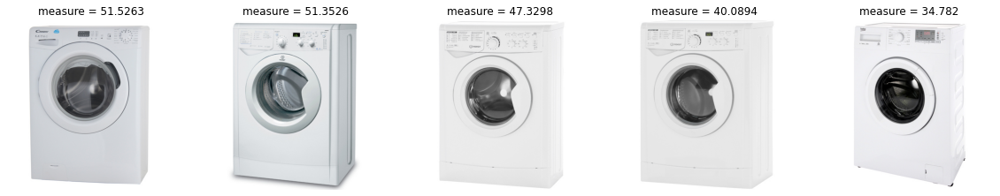

In [67]:
clb.user_based(12345)

Для таких товаров


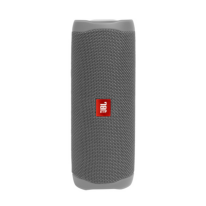

Такие рекомендации


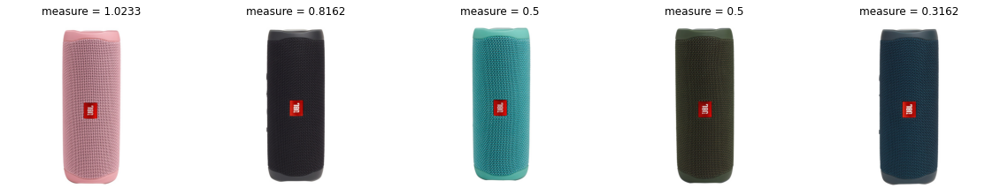

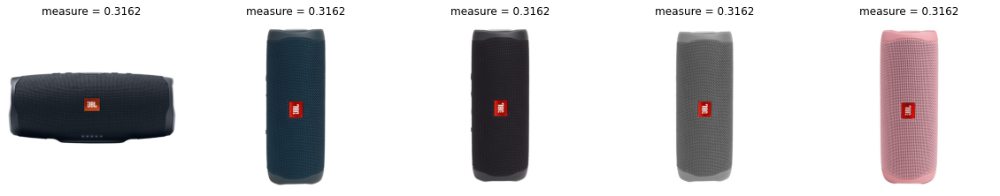

In [68]:
clb.user_based(123456)

Для таких товаров


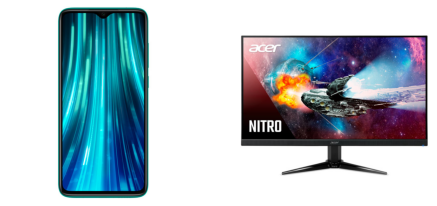

Такие рекомендации


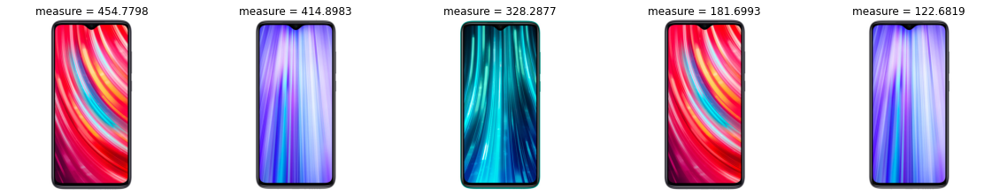

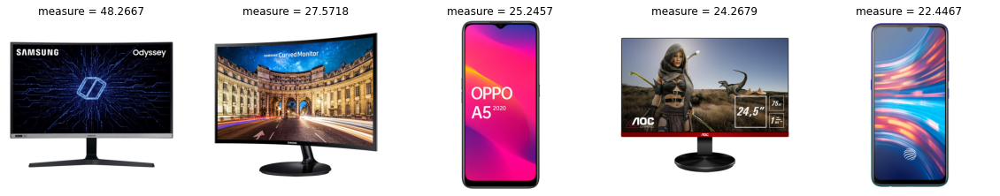

In [69]:
clb.user_based(34434)

Для таких товаров


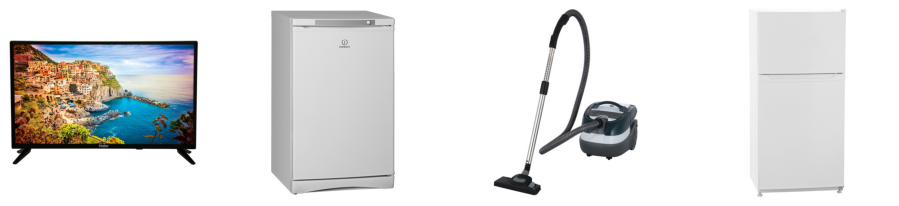

Такие рекомендации


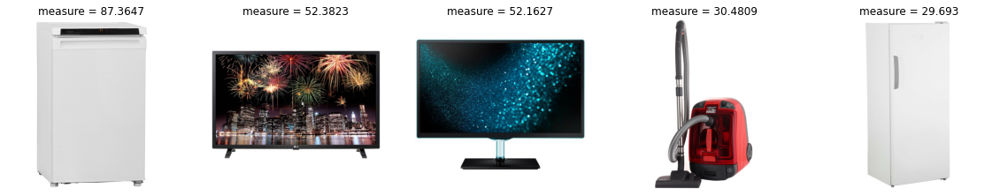

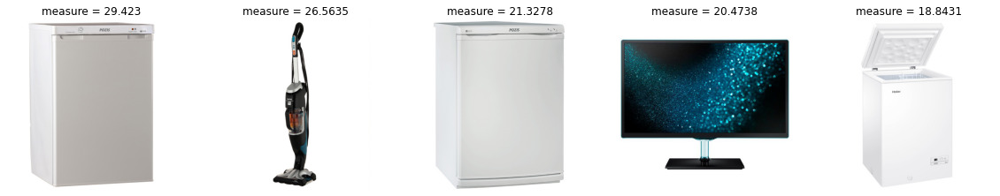

In [70]:
clb.user_based(3333)

Для таких товаров


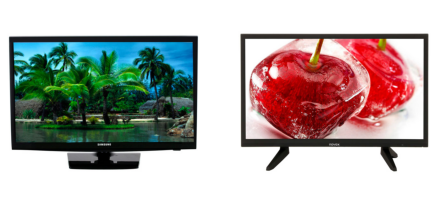

Такие рекомендации


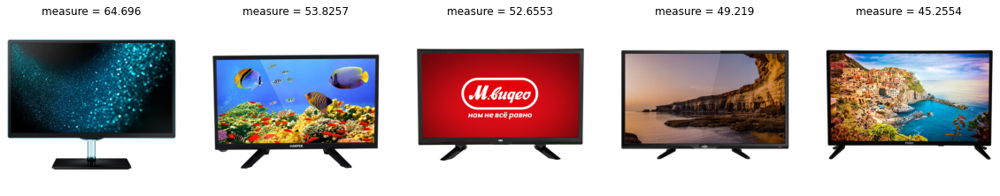

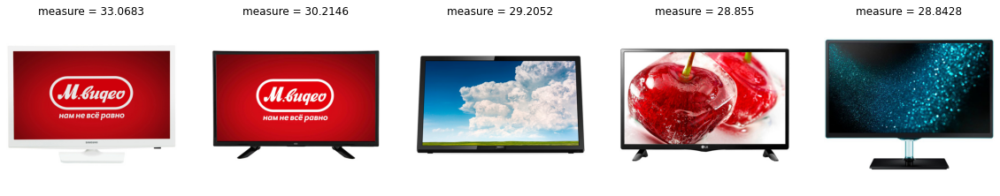

In [71]:
clb.user_based(5555)

Для таких товаров


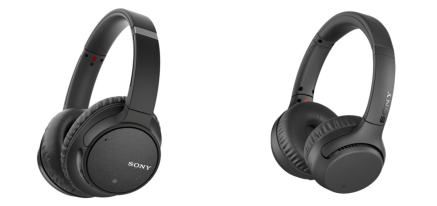

Такие рекомендации


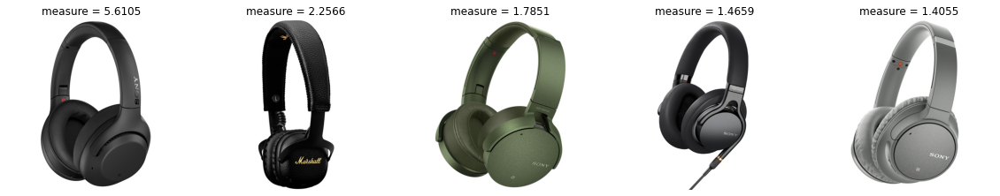

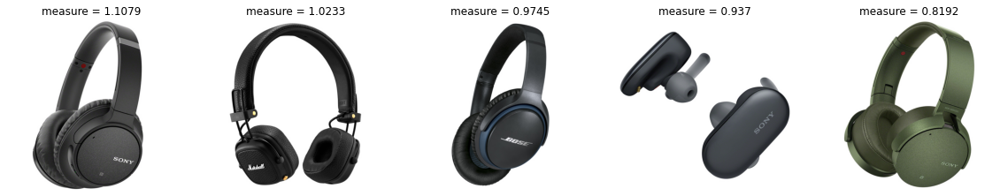

In [72]:
clb.user_based(77777)

Для таких товаров


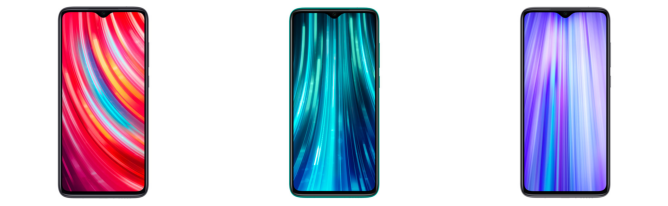

Такие рекомендации


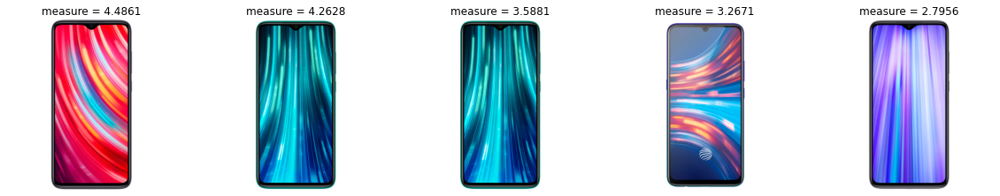

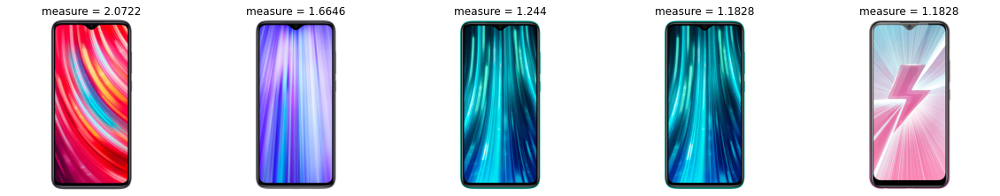

In [73]:
clb.user_based(5)

Для таких товаров


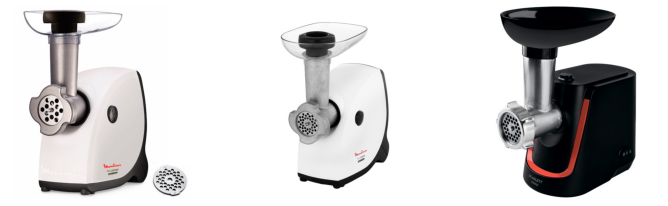

Такие рекомендации


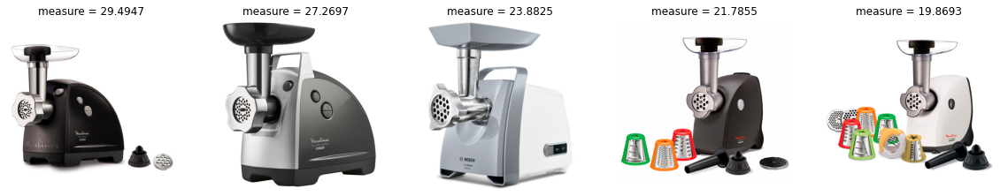

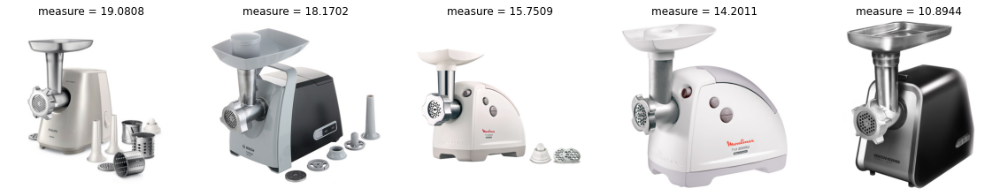

In [74]:
clb.user_based(323)

# Matrix Factorization

In [47]:
class MatrixFactorization():
    
    def __init__(self, interactions, k):
        interactions["product_id"] = interactions["product_id"].astype(int)
        self.k = k
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j
        df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                                   'weight': [1, 1, 1]})
        weighted = interactions.merge(df_weights, on="page_type")\
                          .groupby(["vid", "product_id", "picture_url"])["weight"]\
                          .sum()\
                          .reset_index()
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        self.csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        
    def MF(self):
        U, S, V = svds(self.csr_rates.astype(float), k=self.k)
        self.user_embs = U
        self.items_embs = V.T
        
    def LightFM(self):
        self.model = LightFM(loss='warp', no_components=100, learning_rate=0.03, learning_schedule="adadelta")
        self.model.fit(self.csr_rates, epochs=5, num_threads=40, verbose=True)
        self.user_feature_bias, self.user_feature_embeddings = self.model.get_user_representations()
        self.item_feature_bias, self.items_embs = self.model.get_item_representations()

    def get_rec(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(-metrics)[0][1:11], self.content_dict, -np.round(np.sort(-metrics)[0][1:11], 4))

In [48]:
simple_svd = MatrixFactorization(Int, 30)
simple_svd.MF()

Для товара


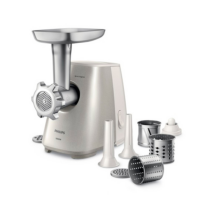

Такие рекомендации


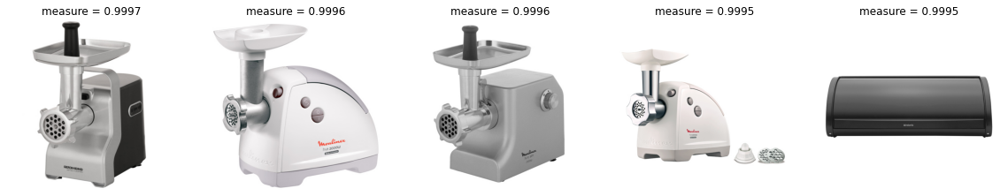

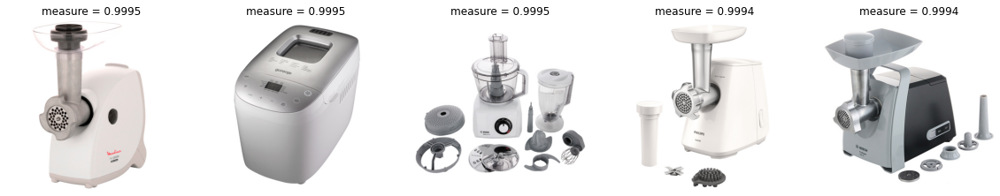

In [49]:
simple_svd.get_rec(10)

Для товара


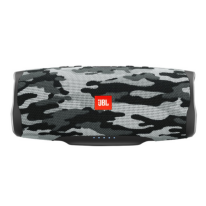

Такие рекомендации


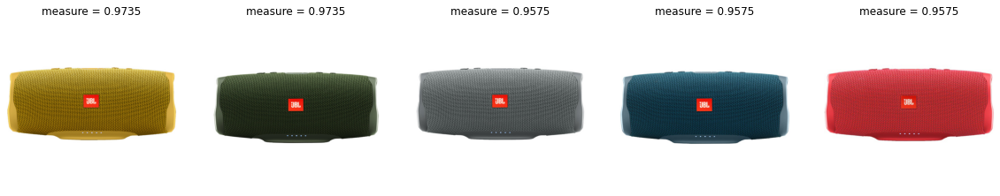

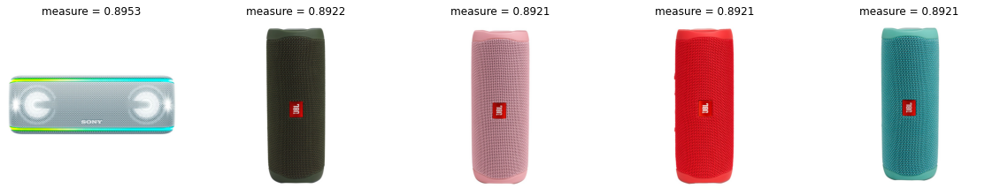

In [50]:
simple_svd.get_rec(1002)

Для товара


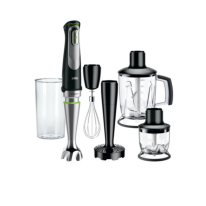

Такие рекомендации


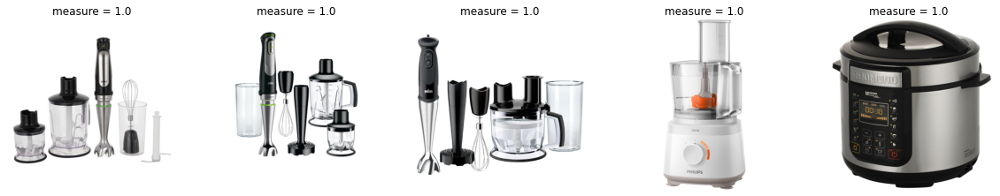

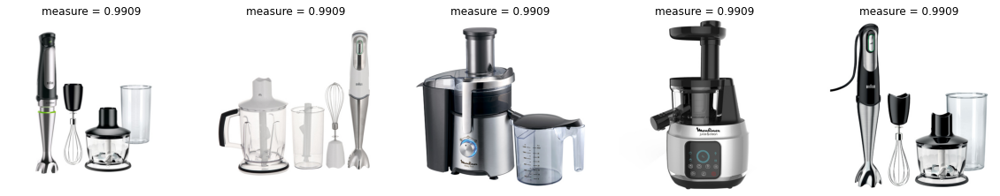

In [51]:
simple_svd.get_rec(10022)

Для товара


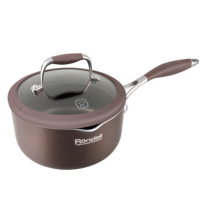

Такие рекомендации


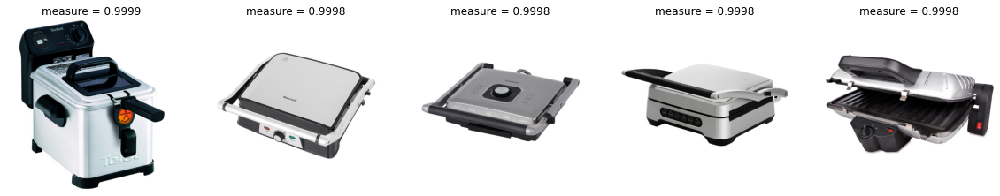

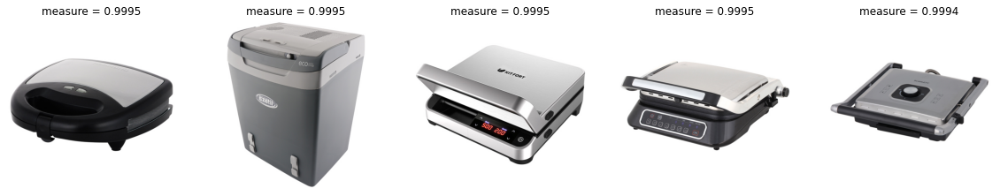

In [80]:
simple_svd.get_rec(12342)

# LightFM

In [52]:
mf = MatrixFactorization(Int, 300)
mf.LightFM()

Epoch 0
Epoch 1
Epoch 2
Epoch 3
Epoch 4


Для товара


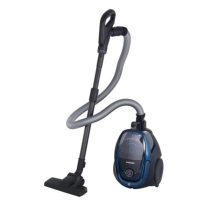

Такие рекомендации


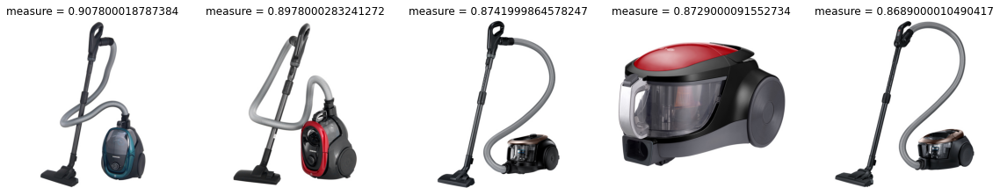

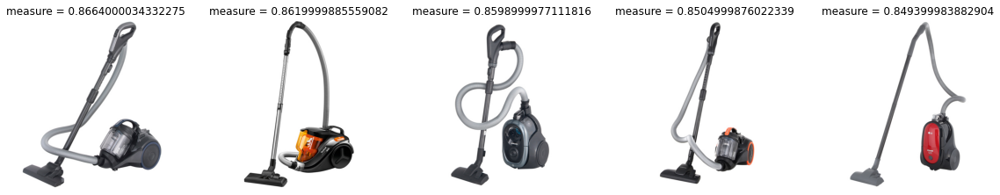

In [53]:
mf.get_rec(123)

Для товара


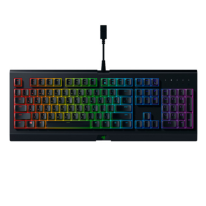

Такие рекомендации


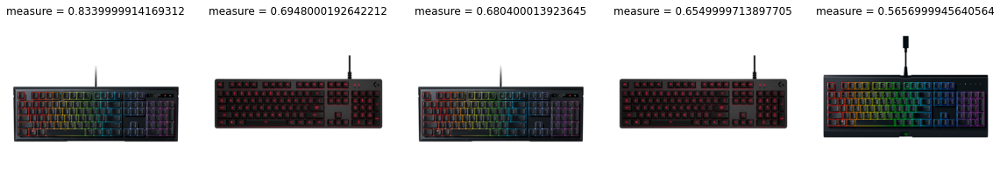

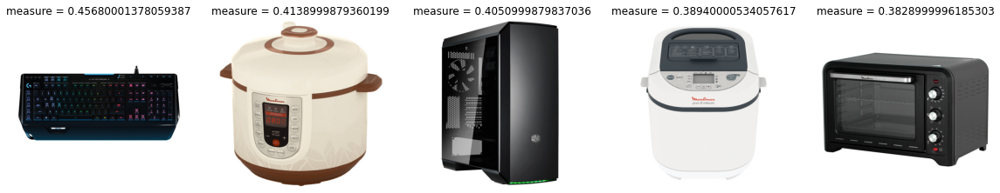

In [54]:
mf.get_rec(1234)

# Домашнее задание

Data contains the book rating information. Ratings (Book-Rating) are either explicit, expressed on a scale from 1-10 (higher values denoting higher appreciation), or implicit, expressed by 0.

### 1. Реализовать персональный топ  - принимает на вход пол и локацию, на выходе персональный топ   - 1 балл

Персональный топ - это топ товаров по похожим возрасту/интересам/локации. Как сделать? Разбить на сегменты по выбраным признакам. Топ делать по книгам с хорошим средним рейтингом.

### 2. На основе метода кластеризации похожих пользователей построить рекомендации (Слайд 25) - 2 балла

Нужно топ-10 рекомендаций с самой высокой оценкой. Считаем среднюю оценку для каждой книги по кластеру и выводим топ-10 книг.

### 3. Применить методы расмотренные на лекции (Совстречаемость - 2 балл, Content-based - 1 балл, Коллаборативная фильтрация - 3 балла , Матричная Факторизация - 1 балл) - 7 баллов

В совстречаемости также учитывать оценки. Вес пары книг встретившихся у пользователя - полусумма их оценок

Коллаборативную фильтрацию реализовывать как на слайде 50 презентации, посоветовав каждому пользователю топ-10 книг с самой высокой оценкой. Сделать рекомендации User-based и Item-based и сравнить.

Если совсем сложно - можно сделать как в семинарской части, поставив оценку "0", если рейтинг < 5 и "1" - в противном случае. Тогда максимум за это - 1 балл.

Для Content-based, Коллаборативной фильтрации, Матричной Факторизации реализовать U2I и I2I рекомендации

### Примечание:

Так как пользователей много - можно зафиксировать несколько произвольных и для них уже составлять рекомендации
Работоспособность I2I можно проверять на известных книгах (Гарри Поттер, Властелин Колец, Интервью с вампиром, Код-Да-Винчи, Маленький Принц)
Рейтинг книг обязательно нужно учитывать

Не забываем также предобработать данные - выкинуть выбросы-пользователей и выбросы-книги.

# Дедлайн 30 ноября
# Жесткий дедлайн - 7 декабря

Выводить в качестве рекомендаций лучше названия книг, картинки (если они есть) и соответствующие метрики близости.
Присылать в виде ноутбука


In [435]:
books = pd.read_csv("BX-Books.csv")

D:\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3146: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [436]:
books = books[books['Year-Of-Publication'].apply(lambda x: str(x).isnumeric())]

In [437]:
books = books[(pd.to_numeric(books['Year-Of-Publication']) < 2020)\
              & (pd.to_numeric(books['Year-Of-Publication']) != 0)]

In [438]:
#books.dropna(inplace=True)

In [439]:
interactions = pd.read_csv("BX-Book-Ratings.csv", sep=";", encoding = "ISO-8859-1")

In [440]:
interactions.head()

,User-ID,ISBN,Book-Rating
0,276725,034545104X,0
1,276726,0155061224,5
2,276727,0446520802,0
3,276729,052165615X,3
4,276729,0521795028,6


In [441]:
interactions = interactions[interactions["Book-Rating"] != 0]

In [442]:
books_meets = interactions.groupby("ISBN")["User-ID"].count().reset_index().rename(columns={"User-ID": "user_num"})

In [443]:
user_meets = interactions.groupby("User-ID")["ISBN"].count().reset_index().rename(columns={"ISBN": "books_num"})

In [444]:
interactions = interactions.merge(books_meets, on=["ISBN"]).merge(user_meets, on=["User-ID"])

In [445]:
interactions = interactions[(interactions["user_num"] > 5) & 
                            (interactions["books_num"] > 5) &
                            (interactions["books_num"] < 200)]

In [446]:
users = pd.read_csv('BX-Users.csv', delimiter=';', encoding = 'ISO-8859-1')

In [447]:
users = users[(users['Age'] < 120) & (users['Age'] > 0)]

In [448]:
interactions = interactions.merge(books[["ISBN", "Image-URL-M", "Book-Title"]].rename(
    columns={"Image-URL-M": "picture_url"}), on=["ISBN"])

In [449]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()

In [450]:
interactions["product_id"] = le.fit_transform(interactions["ISBN"])
interactions["vid"] = le.fit_transform(interactions["User-ID"])

In [451]:
books.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...,http://images.amazon.com/images/P/0060973129.0...
3,0374157065,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...,http://images.amazon.com/images/P/0374157065.0...
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...,http://images.amazon.com/images/P/0393045218.0...


In [452]:
interactions.head()

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,3426
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,5220
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,2608
3,276866,3404139178,9,8,11,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,10830
4,106534,3404139178,6,8,6,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,4205


In [453]:
users['Location'].value_counts()

london, england, united kingdom             1617
sydney, new south wales, australia          1406
madrid, madrid, spain                       1325
toronto, ontario, canada                    1225
melbourne, victoria, australia              1057
                                            ... 
hjhjjjj, alaska, italy                         1
brentford, middlesex, united kingdom           1
wendorf, mecklenburg-vorpommern, germany       1
columbus, arkansas, usa                        1
lincs, england, united kingdom                 1
Name: Location, Length: 41151, dtype: int64

In [454]:
users.head()

,User-ID,Location,Age
1,2,"stockton, california, usa",18.0
3,4,"porto, v.n.gaia, portugal",17.0
5,6,"santa monica, california, usa",61.0
9,10,"albacete, wisconsin, spain",26.0
10,11,"melbourne, victoria, australia",14.0


In [455]:
csr_rates = coo_matrix((interactions["Book-Rating"], (interactions["vid"], interactions["product_id"])), 
                            shape=(len(set(interactions["vid"])), len(set(interactions["product_id"]))))

### Ищем id нужных книг

In [260]:
for i, j in interactions[["product_id", "Book-Title"]].drop_duplicates().values:
    if "David Copperfield" in j:
        print("idx:", i, "\tBook Title:", j)

idx: 10067 	Book Title: David Copperfield (Wordsworth Classics)
idx: 1041 	Book Title: David Copperfield (Penguin Classics)


In [261]:
class User_Clustering():
    def __init__(self, Int):
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
    def Get_rec_Clustering(self, i):
        user = users.loc[users['User-ID'] == self.interactions["User-ID"][i]].values.tolist()
        print(user)
        location = user[0][1]
        age = user[0][2]
        print(location, age)
        print(users[users['Location'] == location])
        cluster = 
        #items = self.interactions[self.interactions["page_type"] == "PURCHASE"]\
           #                                     .groupby("product_id")["vid"].count() \
          #                                      .reset_index() \
         #                                       .sort_values("vid", ascending=False)[:30]
        
        #rec_imaging(items["product_id"].values, self.product_id_to_url, items["vid"].values)

SyntaxError: invalid syntax (<ipython-input-261-dd141899224d>, line 15)

In [262]:
usr = User_Clustering(interactions)

In [263]:
usr.Get_rec_Clustering(10)

[[239467, 'albstadt, baden-wuerttemberg, germany', 23.0]]
albstadt, baden-wuerttemberg, germany 23.0
        User-ID                               Location   Age
235039   235040  albstadt, baden-wuerttemberg, germany  36.0
239466   239467  albstadt, baden-wuerttemberg, germany  23.0


In [279]:
Int

,vid,product_id,page_type,picture_url,text
0,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
1,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
2,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
3,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
4,0,0,PRODUCT,https://img.mvideo.ru/Pdb/10018823b.jpg,10018823 16 xtreme 2 black 390 jbl беспроводна...
...,...,...,...,...,...
646130,129903,60018,PRODUCT,https://img.mvideo.ru/Pdb/50129703b.jpg,50129703 84 iphone 11 pro max leather folio au...
646131,129903,60018,PRODUCT,https://img.mvideo.ru/Pdb/50129703b.jpg,50129703 84 iphone 11 pro max leather folio au...
646132,129906,60021,PRODUCT,https://img.mvideo.ru/Pdb/50050599b.jpg,50050599 8 c6t cs cv248 ao 32wfr 195 ezviz ip ...
646133,129906,60021,PRODUCT,https://img.mvideo.ru/Pdb/50050599b.jpg,50050599 8 c6t cs cv248 ao 32wfr 195 ezviz ip ...


In [280]:
interactions

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,3426
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,5220
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,2608
3,276866,3404139178,9,8,11,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,10830
4,106534,3404139178,6,8,6,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,4205
...,...,...,...,...,...,...,...,...,...
109537,27551,0849912970,10,6,6,http://images.amazon.com/images/P/0849912970.0...,Traveling Light: Releasing the Burdens You Wer...,9377,1030
109538,206652,1860465811,9,8,10,http://images.amazon.com/images/P/1860465811.0...,Wind-Up Bird Chronicle,10098,8072
109539,223525,1588720284,8,6,13,http://images.amazon.com/images/P/1588720284.0...,Why Your Life Sucks: And What You Can Do Abou...,10031,8711
109540,94153,0060652926,9,7,14,http://images.amazon.com/images/P/0060652926.0...,Mere Christianity,268,3720


In [376]:
#В совстречаемости также учитывать оценки. Вес пары книг встретившихся у пользователя - полусумма их оценок
# Совстречаемость
class Recomendations():
    def __init__(self, Int):
        self.product_id_to_url = {}
        for i in Int[["product_id", "picture_url"]].drop_duplicates().values:
            self.product_id_to_url[i[0]] = i[1]
        self.interactions = Int
        
        
    def coocurrency_count(self):
        Int = self.interactions[["vid", "product_id", "Book-Rating"]].drop_duplicates()
        user_products = Int.groupby(["vid"])["product_id"].apply(list).reset_index()
        user_rates = Int.groupby(["vid"])["Book-Rating"].apply(list).reset_index()
        user_products['Rates'] = user_rates["Book-Rating"]
        product_num = [len(i) for i in user_products["product_id"]]
        #book_arrs = user_products["product_id"].tolist()
       # self.get_rating(book_arrs)
        #book_rates = [i for i in get_rating(user_products["product_id"])]
        user_products["prod_num"] = product_num
        user_products = user_products[user_products["prod_num"] > 1]
       # print(user_products)
        cooc = {}
        for i in tqdm.tqdm_notebook(user_products.values):
            for j in range(len(i[1])):
                for k in range(len(i[1])):
                    #print(i)
                    if j != k:
                        try:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] += (i[2][j] + i[2][k]) / 2
                        except:
                            cooc[str(i[1][j]) + "_" + str(i[1][k])] = (i[2][j] + i[2][k]) / 2
        cooc_list = []
        #j != 1 ubrat potencialno
        for i, j in cooc.items():
            if j != 1:
                cooc_list.append(i.split("_") + [j])
        self.cooc_rec = pd.DataFrame(cooc_list, columns=["item1", "item2", "measure"])
    
    def get_rec(self, i, show=False):
        recs = self.cooc_rec[self.cooc_rec["item1"] == str(i)]\
                            .sort_values("measure", ascending=False)\
                            .head(10)
        print(u"Для товара")
        rec_imaging([i], self.product_id_to_url)
        print(u"Такие рекомендации")
        rec_imaging(recs["item2"].values.astype(int), self.product_id_to_url, 
                         recs["measure"].values.astype(int))

In [377]:
cooc_rec = Recomendations(interactions)
cooc_rec.coocurrency_count()

<ipython-input-376-1f4817ad3e05>:24: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i in tqdm.tqdm_notebook(user_products.values):


Для товара


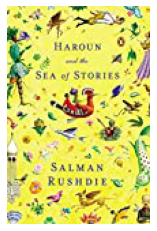

Такие рекомендации


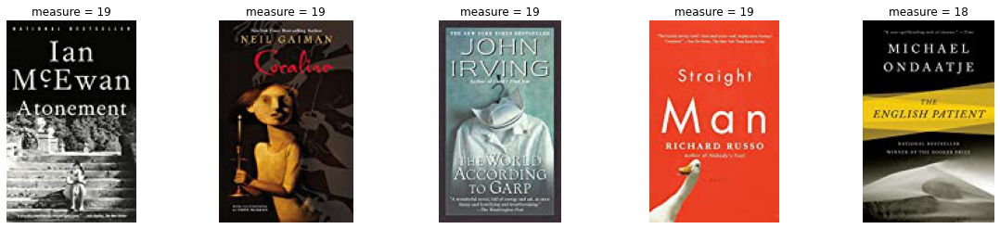

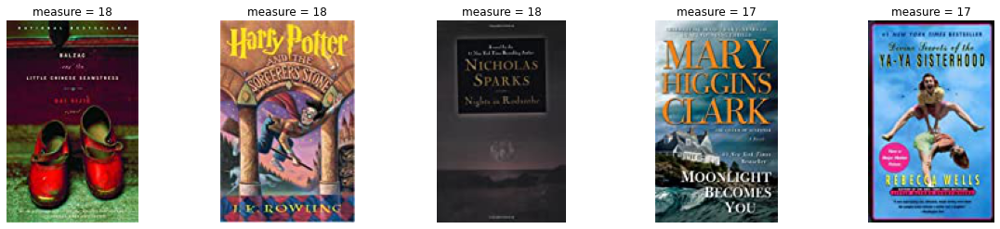

In [378]:
cooc_rec.get_rec(867)

In [281]:
#Для Content-based, Коллаборативной фильтрации, Матричной Факторизации реализовать U2I и I2I рекомендации
class Content_Based():
    def __init__(self, items, interactions):
        self.items = items
        self.interactions = interactions
        self.content_dict = {}
        for i, j in enumerate(items["Image-URL-M"]):
            self.content_dict[i] = j
        self.inversed_dict = {v: k for k, v in self.content_dict.items()}
        
    def avg_feature_vector(self, words, model, num_features, index2word_set):
        feature_vec = np.zeros((num_features, ), dtype='float32')
        n_words = 0
        for word in words:
            if word in index2word_set:
                n_words += 1
                feature_vec = np.add(feature_vec, model.wv[word])
        if (n_words > 0):
            feature_vec = feature_vec / n_words
        return feature_vec

    def get_items_representation(self): 
        
        #self.interactions['descr_col'] =  self.items['Book-Title'] + self.items['Book-Author']
        #self.interactions['descr_col']  = self.interactions['descr_col'].astype('str') 
        item_description = [gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", i.lower())) 
                            for i in self.items['Book-Title']]
        #build vocabulary and train model
        self.model = gensim.models.Word2Vec(
                item_description,
                size=200,
                window=10,
                min_count=1,
                workers=10,
                iter=100)
        self.index2word_set = set(self.model.wv.index2word)
        self.items_embs = np.zeros((len(item_description), 200))
        for i in range(self.items_embs.shape[0]):
            self.items_embs[i] = self.avg_feature_vector(item_description[i], self.model, 200, self.index2word_set)
        
        
    def get_rec_I2I(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])


    def get_rec_U2I(self, i):
        ui = self.interactions[self.interactions["vid"] == i]
        user_vector = " ".join(ui["Book-Title"])
        user_processed = gensim.utils.simple_preprocess(re.sub("[^a-zA-Zа-яА-Я]+", " ", user_vector.lower()))
        user_emb = self.avg_feature_vector(user_processed, self.model, 200, self.index2word_set)
        metrics = cosine_similarity([user_emb], self.items_embs)
        print(u"Для пользователя, который взаимодействовал с товарами")
        rec_imaging(np.unique([self.inversed_dict[i] for i in ui["picture_url"]]), self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(metrics)[0][::-1][1:11], self.content_dict, np.sort(metrics)[0][::-1][1:11])

In [282]:
interactions[interactions["User-ID"] == 27551]

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid
74106,27551,0310205719,10,34,6,http://images.amazon.com/images/P/0310205719.0...,The Purpose-Driven Life: What on Earth Am I He...,1289,1030
109537,27551,0849912970,10,6,6,http://images.amazon.com/images/P/0849912970.0...,Traveling Light: Releasing the Burdens You Wer...,9377,1030


In [283]:
CB = Content_Based(books, interactions)

In [284]:
CB.get_items_representation()

In [285]:
#tell me pryam vo 24

Для товара


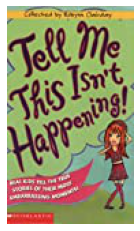

Такие рекомендации


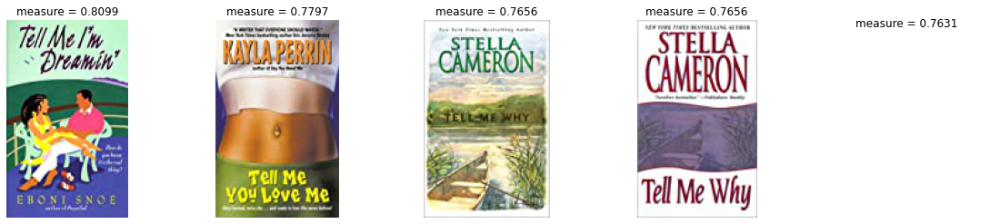

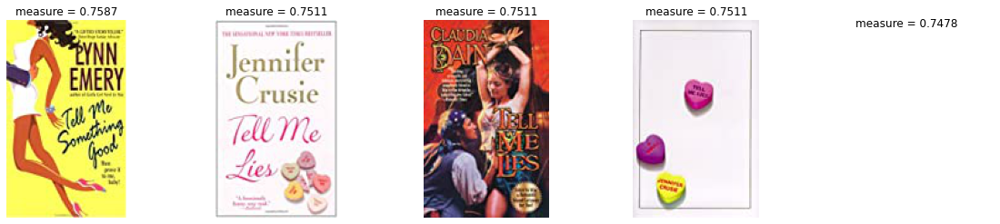

In [292]:
CB.get_rec_I2I(24)

Для пользователя, который взаимодействовал с товарами


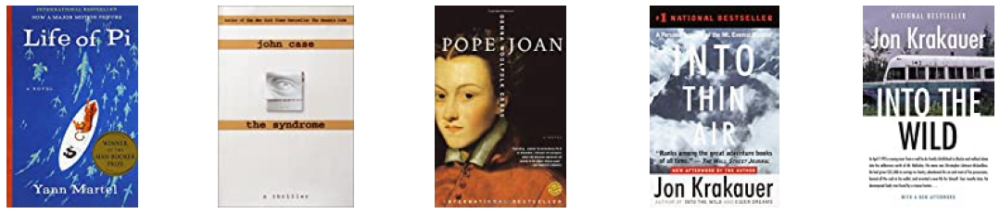

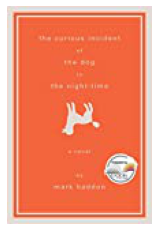

Такие рекомендации


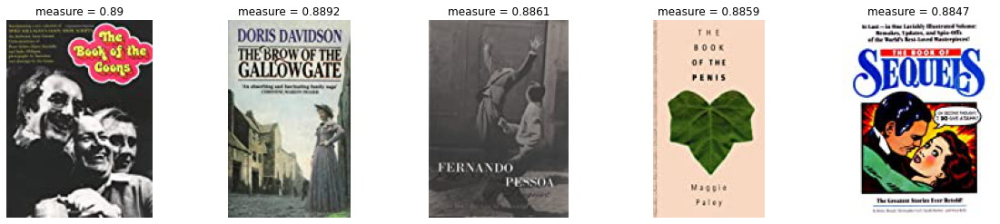

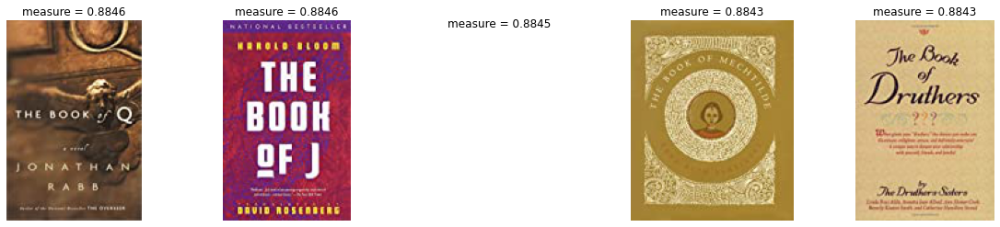

In [297]:
CB.get_rec_U2I(45)

In [460]:
interactions

,User-ID,ISBN,Book-Rating,user_num,books_num,picture_url,Book-Title,product_id,vid,weight
0,86583,3404139178,9,8,18,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,3426,1.0
1,132500,3404139178,10,8,43,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,5220,1.0
2,66483,3404139178,10,8,83,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,2608,1.0
3,276866,3404139178,9,8,11,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,10830,1.0
4,106534,3404139178,6,8,6,http://images.amazon.com/images/P/3404139178.0...,Das Lacheln der Fortuna: Historischer Roman,10268,4205,1.0
...,...,...,...,...,...,...,...,...,...,...
109537,27551,0849912970,10,6,6,http://images.amazon.com/images/P/0849912970.0...,Traveling Light: Releasing the Burdens You Wer...,9377,1030,1.0
109538,206652,1860465811,9,8,10,http://images.amazon.com/images/P/1860465811.0...,Wind-Up Bird Chronicle,10098,8072,1.0
109539,223525,1588720284,8,6,13,http://images.amazon.com/images/P/1588720284.0...,Why Your Life Sucks: And What You Can Do Abou...,10031,8711,1.0
109540,94153,0060652926,9,7,14,http://images.amazon.com/images/P/0060652926.0...,Mere Christianity,268,3720,1.0


In [458]:
class Colloborative():
    def __init__(self, interactions):
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[int(i)] = j
            '''
        df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                                   'weight': [1, 1, 1]})
        weighted = interactions.merge(df_weights, on="page_type")\
                          .groupby(["vid", "product_id", "picture_url"])["weight"]\
                          .sum()\
                          .reset_index()
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        '''
        #df.loc[df['eri_white']==1,'race_label'] = 'White'
        interactions.loc[interactions['Book-Rating'] < 5, 'weight'] = 0
        interactions.loc[interactions['Book-Rating'] >= 5, 'weight'] = 1
        #print(interactions[100:140])
        weighted = interactions[["vid", "product_id", "picture_url", "weight"]]
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        self.csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        

    def user_based(self, idx):
        # считаем косинус между пользователем idx и всеми пользователями
        user_rates = self.csr_rates.getrow(idx).toarray()[0]
        watched_items = np.where(user_rates != 0)[0]
        metrics = cosine_similarity([user_rates], self.csr_rates).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.copy(), metrics)
        # чтобы не рекомендовать уже просмотренные - зануляем веса просмотренных
        total_rate = (1 - user_rates.astype(bool)) * np.array(np.sum(rates, axis=0))[0]
        # печатаем рекомендации
        self.get_rec(watched_items, np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])
        
    def item_based(self, idx):
        # считаем косинус между пользователем idx и всеми пользователями
        item_rates = self.csr_rates.getcol(idx).toarray().reshape(1, -1)
        metrics = cosine_similarity(item_rates, self.csr_rates.T).reshape(-1, 1)
        # домножаем оценки пользователя на коэффициент похожести
        rates = csr_matrix.multiply(self.csr_rates.T.copy(), metrics)
        total_rate = np.array(np.sum(rates, axis=1)).ravel()
        # печатаем рекомендации
        self.get_rec([idx], np.arange(self.csr_rates.shape[1])[np.argsort(total_rate)[::-1][:10]],
                    np.sort(total_rate)[::-1][:10])

    def get_rec(self, watched, recs, measure):
        print(u"Для таких товаров")
        rec_imaging([i for i in watched], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging([i for i in recs], self.content_dict, measure)

In [459]:
clb = Colloborative(interactions)

     User-ID        ISBN  Book-Rating  user_num  books_num  \
100   126492  0743211383           10        57        128   
101   206219  0743211383            8        57         52   
102    48995  0743211383            5        57         13   
103   112914  0743211383            6        57         29   
104   136829  0743211383            2        57         16   
105   236959  0743211383            7        57         54   
106   189080  0743211383            4        57         66   
107   155989  0743211383            5        57          8   
108   163570  0743211383            8        57         96   
109    27617  0743211383           10        57         96   
110   193819  0743211383            8        57          7   
111   228374  0743211383            7        57          6   
112    71234  0743211383            5        57         36   
113   225989  0743211383           10        57         14   
114   109901  0743211383           10        57        105   
115   20

<ipython-input-458-c7e692e6971d>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weighted["weight"] = (weighted["weight"] > 0).astype(int)


Для таких товаров


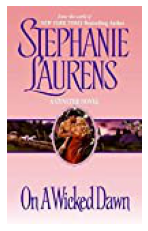

Такие рекомендации


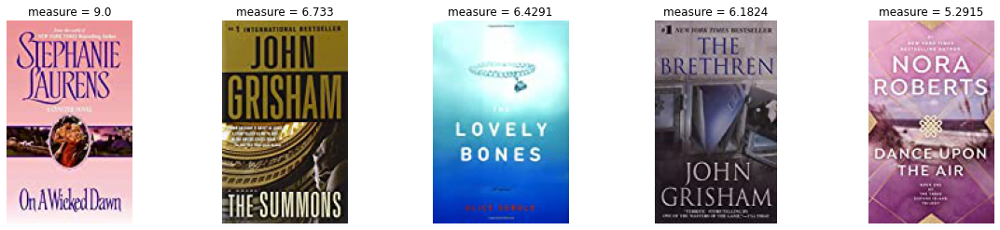

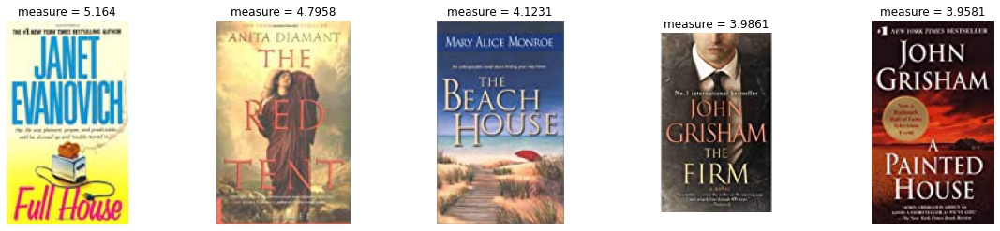

In [461]:
clb.item_based(44)

Для таких товаров


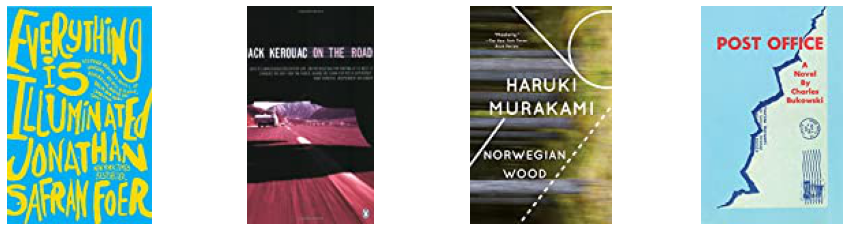

Такие рекомендации


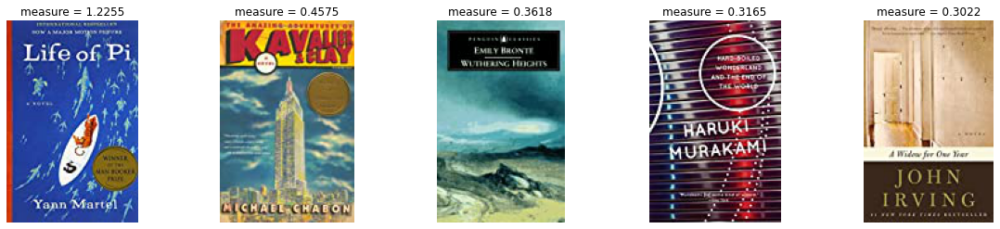

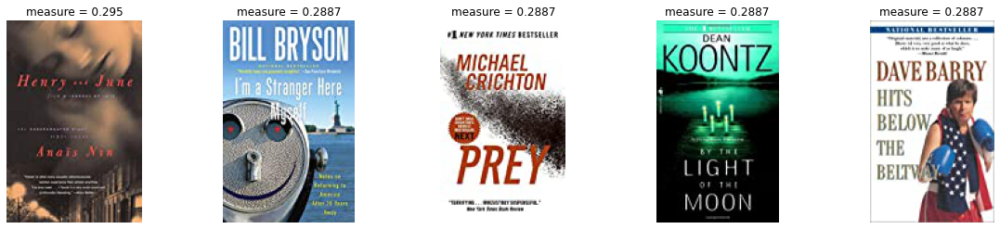

In [462]:
clb.user_based(24)

In [411]:
class MatrixFactorization():
    
    def __init__(self, interactions, k):
        interactions["product_id"] = interactions["product_id"].astype(int)
        self.k = k
        self.content_dict = {}
        for i, j in interactions[["product_id", "picture_url"]].drop_duplicates().values:
            self.content_dict[i] = j
            '''
        df_weights = pd.DataFrame({"page_type": ["PRODUCT", "CART", "PURCHASE"],
                                   'weight': [1, 1, 1]})
        weighted = interactions.merge(df_weights, on="page_type")\
                          .groupby(["vid", "product_id", "picture_url"])["weight"]\
                          .sum()\
                          .reset_index()
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        '''
        interactions.loc[interactions['Book-Rating'] < 5, 'weight'] = 0
        interactions.loc[interactions['Book-Rating'] >= 5, 'weight'] = 1
        weighted = interactions[["vid", "product_id", "picture_url", "weight"]]
        weighted["weight"] = (weighted["weight"] > 0).astype(int)
        self.csr_rates = coo_matrix((weighted["weight"], (weighted["vid"], weighted["product_id"])), 
                            shape=(len(set(weighted["vid"])), len(set(weighted["product_id"]))))
        
    def MF(self):
        U, S, V = svds(self.csr_rates.astype(float), k=self.k)
        self.user_embs = U
        self.items_embs = V.T
        
    def LightFM(self):
        self.model = LightFM(loss='warp', no_components=100, learning_rate=0.03, learning_schedule="adadelta")
        self.model.fit(self.csr_rates, epochs=5, num_threads=40, verbose=True)
        self.user_feature_bias, self.user_feature_embeddings = self.model.get_user_representations()
        self.item_feature_bias, self.items_embs = self.model.get_item_representations()

    def get_rec(self, i):
        metrics = cosine_similarity([self.items_embs[i]], self.items_embs)
        print(u"Для товара")
        rec_imaging([i], self.content_dict)
        print(u"Такие рекомендации")
        rec_imaging(np.argsort(-metrics)[0][1:11], self.content_dict, -np.round(np.sort(-metrics)[0][1:11], 4))

In [416]:
simple_svd = MatrixFactorization(interactions, 30)
simple_svd.MF()

<ipython-input-411-36355966eacd>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weighted["weight"] = (weighted["weight"] > 0).astype(int)


Для товара


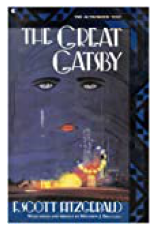

Такие рекомендации


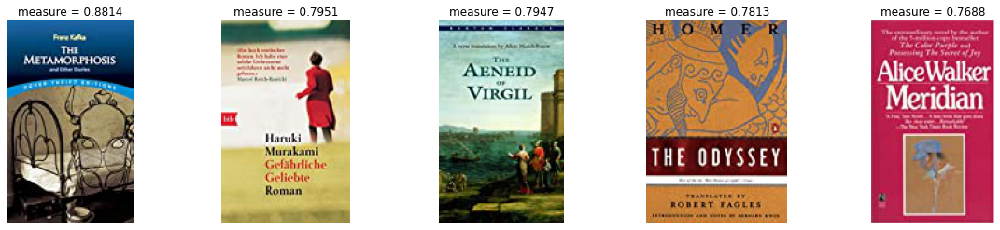

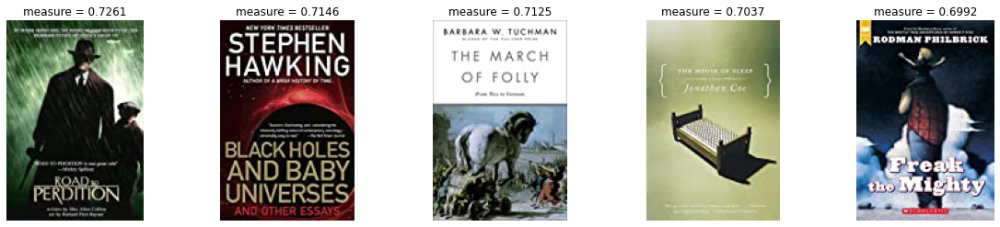

In [418]:
simple_svd.get_rec(12)

In [414]:
mf = MatrixFactorization(interactions, 300)
mf.LightFM()

<ipython-input-411-36355966eacd>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weighted["weight"] = (weighted["weight"] > 0).astype(int)


Epoch 0
Epoch 1
Epoch 2
Epoch 3
Epoch 4


Для товара


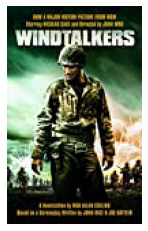

Такие рекомендации


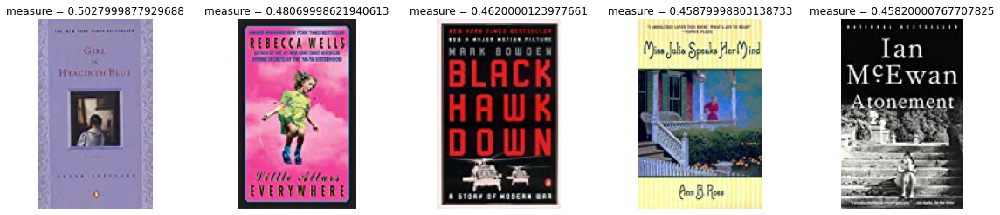

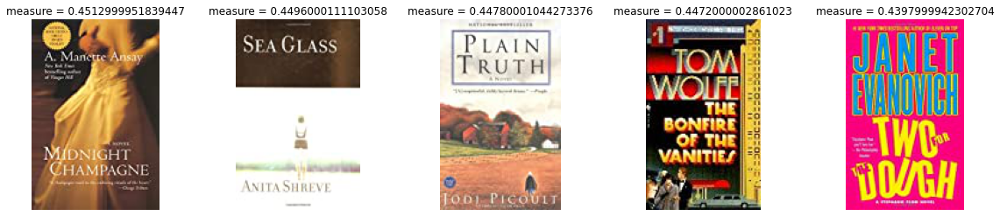

In [421]:
mf.get_rec(42)